# Universidad Nacional de Córdoba 
# Facultad de Matemática, Astronomía, Física y Computación
# Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones 2022
# Predicción de incidendes viales en la ciudad de Medellin

> Mentora: Isabel Mejia

> Estudiantes: Candela Spitale | Gustavo Venchiarutti | Carina Giovine


Se trabaja con un dataset del portal de datos de la ciudad de Medellin-MEData
[Victimas de Incidentes viales](http://medata.gov.co/dataset/v%C3%ADctimas-en-incidentes-viales)


# TRABAJO PRÁCTICO DE APRENDIZAJE NO SUPERVISADO
Continuaremos con el estudio de la predicción de los incidentes viales en la ciudad de Medellin, implementando modelos utilizados en aprendizaje no supervisado. Algunos investigadores emplean las tecnicas del aprendizaje no supervisado, y despues continuan con las metodologías del aprendizaje supervisado.  En el aprendizaje no supervisado, se pretende realizar un análisis mas profundo de los datos y hallar patrones de comportamiento de los datos sin efectos externos. 


1. Exploración

Antes de empezar a aplicar algunos algoritmos de clustering, es necesario que el dataset este limpio, asi como tambien encoding de variables categoricas. 

2. Descripción

*  Analicemos la correlación positiva de las features de nuestro dataset. Identifiquemos y visualicemos los pares de features de correlación positiva.¿Estas features difieren de las identificadas en el TP3? 


3. Apliquemos algunos algoritmos de clustering, como: Density-based spatial clustering of applications with noise -DBSCAN, K-means, Mixture Gaussianas. ¿Cuales hiperparametros han decidido analizar de cada algoritmo?  ¿Es necesaria la normalización de los datos , si normalizas los datos, se alteran los resultados de los hiperparámetros? 

4. Analiza los resultados obtenidos, compara los modelos aplicados.[Comparando algunos algoritmos de clustering](https://github.com/DiploDatos/AprendizajeNOSupervisado/blob/master/notebooks_clustering/note_fig1.ipynb). ¿Difieron los resultados obtenidos en Clustering, de los modelos de aprendizaje supervisado?







# Indice

0. [Inicialización del entorno](#Inicialización-del-entorno)

1. [1. EDA y Curación](#1.-EDA-y-Curación)

    2.1. [Selección de Variables](#Selección-de-Variables)
    
    2.2. [Codificación](#Codificación)

2. [Descripción y más selección de variables](#2.-Descripción-y-más-selección-de-variables)
3. [Técnicas de clustering y 4. Evaluación](#3.-Técnicas-de-clustering-y-4.-Evaluación)
    
  3.1. [Mezcla de Gaussianas en subpoblación](#Mezcla-de-Gaussianas-en-subpoblación)
  
  3.2. [Normalización](#Normalización)
    
  3.3. [K-Means](#K-Means)
      - 3.3.1. [Preparación de datos](Preparación-de-datos)

      - 3.3.2. [Analisis del Codo](#Analisis-del-Codo)

      - 3.3.3. [Aplicamos KMeans](#Aplicamos-KMeans)
    
      - 3.3.4. [Análisis del Data Frame](#Análisis-del-Data-Frame)
    
  3.4. [DB-Scan](#DB-Scan)
      - 3.4.1. [Calculo del Epsilon](#Calculo-del-Epsilon)
      - 3.4.2. [Aplicamos DB-Scan](Aplicamos-DB-Scan)
  
  3.5. [Embbeding con PCA](#Embbeding-con-PCA)

      - 3.5.1. [Proceso PCA](#Proceso-PCA)
      - 3.5.2.[Análisis visual PCA](#Análisis-visual-PCA)

          - 3.5.2.1 [Proyección 2D](#Proyección-2D)
          - 3.5.2.2 [Proyección 3D](#Proyección-3D)

      - 3.5.3. [K-Means con PCA](#K-Means-con-PCA)

          - 3.5.2.1 [Analisis del Codo](#Analisis-del-Codo)
          - 3.5.2.2 [Clustering Optimo](#Clustering-Optimo)

      - 3.5.4.[DB-Scan con PCA](#DB-Scan-con-PCA)
          - 3.5.2.1 [Calculo del Epsilon](#Calculo-del-Epsilon)
          - 3.5.2.2 [Aplicamos DB-Scan](Aplicamos-DB-Scan)
      - 3.5.4.[Mezcla de Gaussianas con PCA](#Mezcla-de-Gaussianas-con-PCA)

## Inicialización del entorno

In [1]:
!pip install kmodes
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 4.0 MB/s 
     |████████████████████████████████| 16.7 MB 37.2 MB/s 
     |████████████████████████████████| 6.3 MB 47.0 MB/s 


In [2]:
import itertools
import io
import warnings

import numpy as np
import pandas as pd

# Visualización
import plotly
import plotly.express as px
from plotly.offline import init_notebook_mode, plot,iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)
import matplotlib.pyplot as plt
import plotly.tools as tls
import plotly.figure_factory as ff
import seaborn as sns
from scipy import linalg
import matplotlib as mpl
import itertools

# Aprendizaje No Supervisado y Semi-Supervisado
from sklearn.cluster import KMeans, DBSCAN
# GMM o Mézcla de Gaussianas, usa Expectation Maximization
from sklearn.mixture import GaussianMixture
from kmodes.kprototypes import KPrototypes

#from sklearn import decomposition

from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA

from sklearn.preprocessing import (
    StandardScaler,
    MinMaxScaler,
    OrdinalEncoder,
    OneHotEncoder,
)
# evaluación intrínseca con clases (métricas)
from sklearn.metrics import (
    silhouette_samples, # qué tan compactos son los clusters
    silhouette_score, # qué tan compactos son los clusterscompacto
    homogeneity_score,
    completeness_score,
    v_measure_score, # qué tan compactos son los clusterscompacto
    adjusted_rand_score, # qué tan compactos son los clusters?
    adjusted_mutual_info_score, # prob de que un elem vaya a estar en un cluster dada cierto valor de caracteristica
)

In [3]:
pd.set_option('display.max_columns',100)
pd.set_option('display.max_rows',1000)
warnings.filterwarnings("ignore")

In [4]:
# Gráficos con más resolución
sns.set_context(context='talk', font_scale=0.6)

In [5]:
# importamos el dataset luego de eliminar todos los valores nulos
URL = 'https://drive.google.com/file/d/1KGQZyXQ_8gZcekX7Ywjbd1CSRkz2yoMM/view?usp=sharing'
path = 'https://drive.google.com/uc?export=download&id='+URL.split('/')[-2]
invia_df = pd.read_csv(path, comment="#")

## 1. EDA y Curación

In [6]:
# Verificamos que estén todas las columnas iniciales y no hayan datos faltantes
invia_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211855 entries, 0 to 211854
Data columns (total 19 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Gravedad_victima     211855 non-null  object 
 1   Fecha_incidente      211855 non-null  object 
 2   Hora_incidente       211855 non-null  object 
 3   Clase_incidente      211855 non-null  object 
 4   Direccion_incidente  211855 non-null  object 
 5   Sexo                 211855 non-null  object 
 6   Edad                 211855 non-null  float64
 7   Condicion            211855 non-null  object 
 8   Mes                  211855 non-null  object 
 9   Dia                  211855 non-null  object 
 10  Num_dia              211855 non-null  float64
 11  Hora                 211855 non-null  float64
 12  Grupo_edad           211855 non-null  object 
 13  Año                  211855 non-null  int64  
 14  Radicado             211855 non-null  float64
 15  Latitud          

In [7]:
invia_df.columns

Index(['Gravedad_victima', 'Fecha_incidente', 'Hora_incidente',
       'Clase_incidente', 'Direccion_incidente', 'Sexo', 'Edad', 'Condicion',
       'Mes', 'Dia', 'Num_dia', 'Hora', 'Grupo_edad', 'Año', 'Radicado',
       'Latitud', 'Longitud', 'Comuna', 'Barrio'],
      dtype='object')

In [8]:
object_cols = list(invia_df.select_dtypes(include=['object']).columns)
print("Cantidad de atributos categóricos (nominales y mayoría de ordinales): %s\n" % len(object_cols))
object_cols

Cantidad de atributos categóricos (nominales y mayoría de ordinales): 12



['Gravedad_victima',
 'Fecha_incidente',
 'Hora_incidente',
 'Clase_incidente',
 'Direccion_incidente',
 'Sexo',
 'Condicion',
 'Mes',
 'Dia',
 'Grupo_edad',
 'Comuna',
 'Barrio']

In [9]:
numeric_cols = list(invia_df.select_dtypes(include=['float64', 'int64']).columns)
print("Cantidad de atributos numéricos y categórica ordinal: %s\n" % len(numeric_cols))
numeric_cols

Cantidad de atributos numéricos y categórica ordinal: 7



['Edad', 'Num_dia', 'Hora', 'Año', 'Radicado', 'Latitud', 'Longitud']

In [10]:
invia_df[object_cols].describe()

,Gravedad_victima,Fecha_incidente,Hora_incidente,Clase_incidente,Direccion_incidente,Sexo,Condicion,Mes,Dia,Grupo_edad,Comuna,Barrio
count,211855,211855,211855,211855,211855,211855,211855,211855,211855,211855,211855,211855
unique,2,2830,1433,6,28484,3,6,12,7,9,21,363
top,Heridos,2017-08-04,18:00:00,Choque,CR 64 C CL 78,M,Motociclista,Jul,Vie,20 - 29,10 - La Candelaria,Caribe
freq,210131,148,3814,94578,680,144569,127576,19260,31516,84818,36378,3864


In [11]:
invia_df[numeric_cols].describe()

,Edad,Num_dia,Hora,Año,Radicado,Latitud,Longitud
count,211855.000000,211855.000000,211855.000000,211855.000000,2.118550e+05,211855.000000,211855.000000
mean,32.334101,15.723325,13.113648,2017.251965,1.587899e+06,6.254180,-75.577402
std,14.368969,8.750022,5.709060,2.201826,1.498239e+05,0.028827,0.022446
min,0.000000,1.000000,0.000000,2014.000000,1.200000e+01,6.166845,-75.703902
25%,22.000000,8.000000,8.000000,2015.000000,1.510160e+06,6.235352,-75.588005
50%,29.000000,16.000000,14.000000,2017.000000,1.594571e+06,6.254451,-75.574543
75%,40.000000,23.000000,18.000000,2019.000000,1.683092e+06,6.276171,-75.562824
max,97.000000,31.000000,23.000000,2021.000000,1.764421e+06,6.368375,-75.490252


### Selección de Variables

> Para hallar patrones de comportamiento de los datos sin efectos externos, necesitamos considerar todas las variables que no nos aporten información redundante, por lo cual, en principio sólo descartaremos las que están representadas por otras de forma evidente a nuestra vista. Por lo cual, consideraremos:


`Gravedad_victima`, `Clase_incidente`, `Sexo`, `Edad`, `Condicion`, `Hora`, `Dia`, `Num_dia`, `Mes`, `Año`, `Comuna`, `Barrio`, `Latitud`, `Longitud`.

Argumentación:

* *Variables de registro temporal:*

`Fecha_incidente` ya está representada en `Mes`, `Dia`, `Año`, y es menos práctica a la hora de aplicar algoritmos de codificación, por lo cual la descartaremos. 

Descartamos `Hora_incidente` ya que `Hora` la representa y es más práctica.

* *Variables de registro de espacio:*

`Direccion_incidente` se encuentra representada de forma general por las otras variables de ubicación, y es muy poco práctica de representar numéricamente al tener muchos valores distintos, por lo cual también descartaremos esta variable.

* *Carácteristicas propias de las personas involucradas:*

`Grupo_Edad` lo eliminaremos pues ya está representado por `Edad`.

* *Carácteristicas propias del incidente:*

No descartaremos ninguna de esta sección, todas aportan información distinta.

> Por lo cual, eliminamos del Data Set las columnas que descartamos.


In [12]:
df = invia_df.drop([
    'Fecha_incidente', 
    'Hora_incidente', 
    'Direccion_incidente', 
    'Grupo_edad'
], axis=1)

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211855 entries, 0 to 211854
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Gravedad_victima  211855 non-null  object 
 1   Clase_incidente   211855 non-null  object 
 2   Sexo              211855 non-null  object 
 3   Edad              211855 non-null  float64
 4   Condicion         211855 non-null  object 
 5   Mes               211855 non-null  object 
 6   Dia               211855 non-null  object 
 7   Num_dia           211855 non-null  float64
 8   Hora              211855 non-null  float64
 9   Año               211855 non-null  int64  
 10  Radicado          211855 non-null  float64
 11  Latitud           211855 non-null  float64
 12  Longitud          211855 non-null  float64
 13  Comuna            211855 non-null  object 
 14  Barrio            211855 non-null  object 
dtypes: float64(6), int64(1), object(8)
memory usage: 24.2+ MB


### Codificación 

> Variables categóricas a codificar:


In [14]:
onehot_cols = [ 
    'Gravedad_victima',
    'Clase_incidente',
    'Sexo',
    'Condicion',
    'Comuna',
    'Barrio'
]

ordinal_cols = [ 'Mes', 'Dia' ]

In [15]:
df.head(5)

,Gravedad_victima,Clase_incidente,Sexo,Edad,Condicion,Mes,Dia,Num_dia,Hora,Año,Radicado,Latitud,Longitud,Comuna,Barrio
0,Heridos,Otro,M,17.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423940.0,6.266915,-75.559099,04 - Aranjuez,Manrique Central No. 1
1,Heridos,Atropello,M,20.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2
2,Heridos,Atropello,F,18.0,Peatón,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2
3,Heridos,Atropello,M,19.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes
4,Heridos,Atropello,M,39.0,Peatón,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes


In [16]:
df.describe()

,Edad,Num_dia,Hora,Año,Radicado,Latitud,Longitud
count,211855.000000,211855.000000,211855.000000,211855.000000,2.118550e+05,211855.000000,211855.000000
mean,32.334101,15.723325,13.113648,2017.251965,1.587899e+06,6.254180,-75.577402
std,14.368969,8.750022,5.709060,2.201826,1.498239e+05,0.028827,0.022446
min,0.000000,1.000000,0.000000,2014.000000,1.200000e+01,6.166845,-75.703902
25%,22.000000,8.000000,8.000000,2015.000000,1.510160e+06,6.235352,-75.588005
50%,29.000000,16.000000,14.000000,2017.000000,1.594571e+06,6.254451,-75.574543
75%,40.000000,23.000000,18.000000,2019.000000,1.683092e+06,6.276171,-75.562824
max,97.000000,31.000000,23.000000,2021.000000,1.764421e+06,6.368375,-75.490252


> Codificamos categóricas nominales

In [17]:
df_onehot = df.copy()

In [18]:
# Codificamos columnas categóricas nominales
new_columns = []
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
array_result = encoder.fit_transform(df_onehot[onehot_cols])
# renombramos los nombres de las columnas
for col, col_values in zip(onehot_cols, encoder.categories_):
  for col_value in col_values:
    new_columns.append('{}={}'.format(col, col_value))

In [19]:
# Agregamos columnas numéricas
oh_data = np.hstack([array_result, df[numeric_cols].values])
# Agregamos nombres de columnas numéricas
new_columns.extend(numeric_cols)
print("Matrix has shape {}, with columns: {}".format(oh_data.shape, new_columns))

Matrix has shape (211855, 408), with columns: ['Gravedad_victima=Heridos', 'Gravedad_victima=Muertos', 'Clase_incidente=Atropello', 'Clase_incidente=Caida Ocupante', 'Clase_incidente=Choque', 'Clase_incidente=Incendio', 'Clase_incidente=Otro', 'Clase_incidente=Volcamiento', 'Sexo=F', 'Sexo=M', 'Sexo=Sin Inf', 'Condicion=Acompañante de Motocicleta', 'Condicion=Ciclista', 'Condicion=Conductor', 'Condicion=Motociclista', 'Condicion=Pasajero', 'Condicion=Peatón', 'Comuna=01 - Popular', 'Comuna=02 - Santa Cruz', 'Comuna=03 - Manrique', 'Comuna=04 - Aranjuez', 'Comuna=05 - Castilla', 'Comuna=06 - Doce de Octubre', 'Comuna=07 - Robledo', 'Comuna=08 - Villa Hermosa', 'Comuna=09 - Buenos Aires', 'Comuna=10 - La Candelaria', 'Comuna=11 - Laureles Estadio', 'Comuna=12 - La América', 'Comuna=13 - San Javier', 'Comuna=14 - El Poblado', 'Comuna=15 - Guayabal', 'Comuna=16 - Belén', 'Comuna=50 - Corregimiento de San Sebastián de Palmitas', 'Comuna=60 - Corregimiento de San Cristóbal', 'Comuna=70 - Cor

> Codificamos con OrdinalEncoder a categóricas que tienen un cierto orden ya que actúa igual a LabelEncoder solo que se puede volver a la representación inicial de todas las variables.

In [20]:
o_enc = OrdinalEncoder()
ordinal_init_array = df[['Dia', 'Mes']].to_numpy()
ordinal_data = o_enc.fit_transform(ordinal_init_array)

In [21]:
o_enc.categories_

[array(['Dom', 'Jue', 'Lun', 'Mar', 'Mié', 'Sáb', 'Vie'], dtype=object),
 array(['Abr', 'Ago', 'Dic', 'Ene', 'Feb', 'Jul', 'Jun', 'Mar', 'May',
        'Nov', 'Oct', 'Sept'], dtype=object)]

In [22]:
# Agregamos columnas ordinales
data = np.hstack([oh_data, ordinal_data])
# Agregamos nombres de columnas numéricas
new_columns.extend(ordinal_cols)
print("Matrix has shape {}, with columns: {}".format(data.shape, new_columns))

Matrix has shape (211855, 410), with columns: ['Gravedad_victima=Heridos', 'Gravedad_victima=Muertos', 'Clase_incidente=Atropello', 'Clase_incidente=Caida Ocupante', 'Clase_incidente=Choque', 'Clase_incidente=Incendio', 'Clase_incidente=Otro', 'Clase_incidente=Volcamiento', 'Sexo=F', 'Sexo=M', 'Sexo=Sin Inf', 'Condicion=Acompañante de Motocicleta', 'Condicion=Ciclista', 'Condicion=Conductor', 'Condicion=Motociclista', 'Condicion=Pasajero', 'Condicion=Peatón', 'Comuna=01 - Popular', 'Comuna=02 - Santa Cruz', 'Comuna=03 - Manrique', 'Comuna=04 - Aranjuez', 'Comuna=05 - Castilla', 'Comuna=06 - Doce de Octubre', 'Comuna=07 - Robledo', 'Comuna=08 - Villa Hermosa', 'Comuna=09 - Buenos Aires', 'Comuna=10 - La Candelaria', 'Comuna=11 - Laureles Estadio', 'Comuna=12 - La América', 'Comuna=13 - San Javier', 'Comuna=14 - El Poblado', 'Comuna=15 - Guayabal', 'Comuna=16 - Belén', 'Comuna=50 - Corregimiento de San Sebastián de Palmitas', 'Comuna=60 - Corregimiento de San Cristóbal', 'Comuna=70 - Cor

In [23]:
# Convertir el resultado en Dataframe, colocar el nombre a las columnas
df_new = pd.DataFrame(data=data, columns=new_columns)
df_new

,Gravedad_victima=Heridos,Gravedad_victima=Muertos,Clase_incidente=Atropello,Clase_incidente=Caida Ocupante,Clase_incidente=Choque,Clase_incidente=Incendio,Clase_incidente=Otro,Clase_incidente=Volcamiento,Sexo=F,Sexo=M,Sexo=Sin Inf,Condicion=Acompañante de Motocicleta,Condicion=Ciclista,Condicion=Conductor,Condicion=Motociclista,Condicion=Pasajero,Condicion=Peatón,Comuna=01 - Popular,Comuna=02 - Santa Cruz,Comuna=03 - Manrique,Comuna=04 - Aranjuez,Comuna=05 - Castilla,Comuna=06 - Doce de Octubre,Comuna=07 - Robledo,Comuna=08 - Villa Hermosa,Comuna=09 - Buenos Aires,Comuna=10 - La Candelaria,Comuna=11 - Laureles Estadio,Comuna=12 - La América,Comuna=13 - San Javier,Comuna=14 - El Poblado,Comuna=15 - Guayabal,Comuna=16 - Belén,Comuna=50 - Corregimiento de San Sebastián de Palmitas,Comuna=60 - Corregimiento de San Cristóbal,Comuna=70 - Corregimiento de Altavista,Comuna=80 - Corregimiento de San Antonio de Prado,Comuna=90 - Corregimiento de Santa Elena,Barrio=1114,Barrio=1316,Barrio=1418,Barrio=1419,Barrio=1422,Barrio=1423,Barrio=1511,Barrio=1611,Barrio=1612,Barrio=1613,Barrio=813,Barrio=9004,...,Barrio=Suramericana,Barrio=Tejelo,Barrio=Tenche,Barrio=Terminal De Transporte,Barrio=Terminal de Transporte,Barrio=Toscana,Barrio=Travesías,Barrio=Trece de Noviembre,Barrio=Tricentenario,Barrio=Trinidad,Barrio=U.D. Atanasio Girardot,Barrio=U.P.B.,Barrio=Universidad De Antioquia,Barrio=Universidad Nacional,Barrio=Universidad de Antioquia,Barrio=Veinte De Julio,Barrio=Veinte de Julio,Barrio=Versalles No. 1,Barrio=Versalles No. 2,Barrio=Versalles No.1,Barrio=Versalles No.2,Barrio=Villa Carlota,Barrio=Villa Flora,Barrio=Villa Guadalupe,Barrio=Villa Hermosa,Barrio=Villa Liliam,Barrio=Villa Lilliam,Barrio=Villa Niza,Barrio=Villa Nueva,Barrio=Villa Turbay,Barrio=Villa del Socorro,Barrio=Villatina,Barrio=Volcana Guayabal,Barrio=Yarumalito,Barrio=Yolombo,Barrio=Área De Expansión Pajarito,Barrio=Área De Expansión San Antonio De Prado,Barrio=Área de Expansión Altavista,Barrio=Área de Expansión Altos de Calasanz,Barrio=Área de Expansión Pajarito,Barrio=Área de Expansión San Antonio de Prado,Edad,Num_dia,Hora,Año,Radicado,Latitud,Longitud,Mes,Dia
0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,17.0,1.0,0.0,2014.0,1423940.0,6.266915,-75.559099,4.0,3.0
1,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,20.0,1.0,0.0,2014.0,1423921.0,6.289353,-75.553292,4.0,3.0
2,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.0,1.0,0.0,2014.0,1423921.0,6.289353,-75.553292,4.0,3.0
3,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19.0,1.0,0.0,2014.0,1423849.0,6.234327,-75.607611,4.0,3.0
4,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [24]:
df_new.shape 

(211855, 410)

In [25]:
df_new.columns

Index(['Gravedad_victima=Heridos', 'Gravedad_victima=Muertos',
       'Clase_incidente=Atropello', 'Clase_incidente=Caida Ocupante',
       'Clase_incidente=Choque', 'Clase_incidente=Incendio',
       'Clase_incidente=Otro', 'Clase_incidente=Volcamiento', 'Sexo=F',
       'Sexo=M',
       ...
       'Barrio=Área de Expansión San Antonio de Prado', 'Edad', 'Num_dia',
       'Hora', 'Año', 'Radicado', 'Latitud', 'Longitud', 'Mes', 'Dia'],
      dtype='object', length=410)

In [26]:
df_new.describe()

,Gravedad_victima=Heridos,Gravedad_victima=Muertos,Clase_incidente=Atropello,Clase_incidente=Caida Ocupante,Clase_incidente=Choque,Clase_incidente=Incendio,Clase_incidente=Otro,Clase_incidente=Volcamiento,Sexo=F,Sexo=M,Sexo=Sin Inf,Condicion=Acompañante de Motocicleta,Condicion=Ciclista,Condicion=Conductor,Condicion=Motociclista,Condicion=Pasajero,Condicion=Peatón,Comuna=01 - Popular,Comuna=02 - Santa Cruz,Comuna=03 - Manrique,Comuna=04 - Aranjuez,Comuna=05 - Castilla,Comuna=06 - Doce de Octubre,Comuna=07 - Robledo,Comuna=08 - Villa Hermosa,Comuna=09 - Buenos Aires,Comuna=10 - La Candelaria,Comuna=11 - Laureles Estadio,Comuna=12 - La América,Comuna=13 - San Javier,Comuna=14 - El Poblado,Comuna=15 - Guayabal,Comuna=16 - Belén,Comuna=50 - Corregimiento de San Sebastián de Palmitas,Comuna=60 - Corregimiento de San Cristóbal,Comuna=70 - Corregimiento de Altavista,Comuna=80 - Corregimiento de San Antonio de Prado,Comuna=90 - Corregimiento de Santa Elena,Barrio=1114,Barrio=1316,Barrio=1418,Barrio=1419,Barrio=1422,Barrio=1423,Barrio=1511,Barrio=1611,Barrio=1612,Barrio=1613,Barrio=813,Barrio=9004,...,Barrio=Suramericana,Barrio=Tejelo,Barrio=Tenche,Barrio=Terminal De Transporte,Barrio=Terminal de Transporte,Barrio=Toscana,Barrio=Travesías,Barrio=Trece de Noviembre,Barrio=Tricentenario,Barrio=Trinidad,Barrio=U.D. Atanasio Girardot,Barrio=U.P.B.,Barrio=Universidad De Antioquia,Barrio=Universidad Nacional,Barrio=Universidad de Antioquia,Barrio=Veinte De Julio,Barrio=Veinte de Julio,Barrio=Versalles No. 1,Barrio=Versalles No. 2,Barrio=Versalles No.1,Barrio=Versalles No.2,Barrio=Villa Carlota,Barrio=Villa Flora,Barrio=Villa Guadalupe,Barrio=Villa Hermosa,Barrio=Villa Liliam,Barrio=Villa Lilliam,Barrio=Villa Niza,Barrio=Villa Nueva,Barrio=Villa Turbay,Barrio=Villa del Socorro,Barrio=Villatina,Barrio=Volcana Guayabal,Barrio=Yarumalito,Barrio=Yolombo,Barrio=Área De Expansión Pajarito,Barrio=Área De Expansión San Antonio De Prado,Barrio=Área de Expansión Altavista,Barrio=Área de Expansión Altos de Calasanz,Barrio=Área de Expansión Pajarito,Barrio=Área de Expansión San Antonio de Prado,Edad,Num_dia,Hora,Año,Radicado,Latitud,Longitud,Mes,Dia
count,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.00000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,...,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.00000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,211855.000000,2.118550e+05,211855.000000,211855.000000,211855.000000,211855.000000
mean,0.991862,0.008138,0.171042,0.144915,0.446428,0.000104,0.168870,0.068641,0.307611,0.682396,0.009993,0.151778,0.022685,0.02572,0.602185,0.057610,0.140020,0.020684,0.017460,0.043737,0.067532,0.106672,0.038215,0.077761,0.035765,0.043959,0.171712,0.092804,0.031616,0.023370,0.056968,0.066782,0.063586,0.000109,0.014420,0.003299,0.020764,0.002785,0.000005,0.000076,0.000132,0.000085,0.000061,0.000071,0.000005,0.000014,0.000005,0.0000

## 2. Descripción y más selección de variables

> Análisis de correlación del Data Set

In [27]:
# Excluiremos Barrio del mapa de calor solamente para
# apreciar mejor las otras correlaciones
barrio_cols = [ col if col.startswith('Barrio=') else None 
                for col in df_new.columns.tolist() ] 

barrio_cols = [ i for i in barrio_cols if i is not None ]
len(barrio_cols)

363

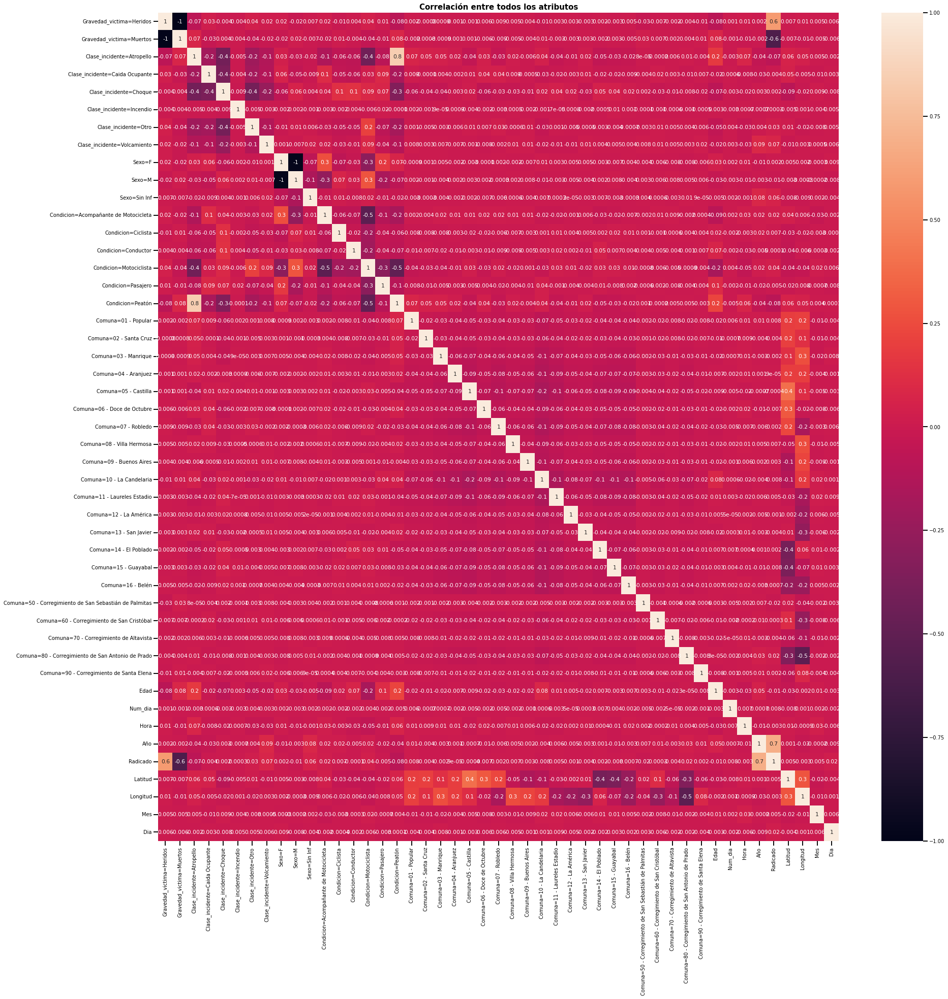

In [28]:
# Graficamos la correlación entre las variables con un mapa de calor
# Hacer/Deshacer zoom con un click en la imagen
fig = plt.figure(figsize=(30,30))
plt.title('Correlación entre todos los atributos', 
            loc='center', fontsize=15, fontweight='bold'
)
df_corr = df_new.loc[:, ~df_new.columns.isin(barrio_cols)]
corr_matrix = df_corr.corr()
sns.heatmap(corr_matrix, fmt='.1g', annot=True)

In [29]:
corr_matrix = df_new.corr()

Considerando un criterio de selección de bastante correlación positiva 0.65, analizando que hay pocas variables correlacionadas, veremos a detalle cuáles son (incluyendo Barrio): 

In [30]:
# crear un dataframe para distinguir cuáles columnas están más correlacionadas y cuáles no
dic = {'Name': None,
        'Index_names':[],
        'Values':[],
        'Max_index': None,
        'Max_value': None,
       }

df_pos = pd.DataFrame(dic)
df_pos

,Name,Index_names,Values,Max_index,Max_value


In [31]:
for col in corr_matrix.columns:
    filtered_rows = []
    # escoger los registros que tengan valores con la columna de acuerdo al criterio 
    # seleccionado
    filtered_rows = corr_matrix.loc[(corr_matrix[col] >= 0.65) & (corr_matrix[col] < 1)]
    if not filtered_rows.empty:
      # crear un arreglo de los índices 
      indices = filtered_rows[col].index.to_numpy()
      # crear un arreglo de los valores
      values = filtered_rows[col].values
      # obtener el nombre de la columna que tiene el mayor valor
      max_idx = filtered_rows[col].idxmax()
      # obtener el mayor valor
      max_value = filtered_rows[col].max()
      # ingresar en el dataframe creado un registro con estos valores
      df_pos.loc[len(df_pos.index)] = [col, indices, values, max_idx, max_value] 

In [32]:
df_pos

,Name,Index_names,Values,Max_index,Max_value
0,Clase_incidente=Atropello,[Condicion=Peatón],[0.8381739360287029],Condicion=Peatón,0.838174
1,Condicion=Peatón,[Clase_incidente=Atropello],[0.8381739360287029],Clase_incidente=Atropello,0.838174
2,Comuna=70 - Corregimiento de Altavista,[Barrio=Altavista Sector Central],[0.6812693036627647],Barrio=Altavista Sector Central,0.681269
3,Comuna=80 - Corregimiento de San Antonio de Prado,[Barrio=Cabecera San Antonio de Prado],[0.8535333319747952],Barrio=Cabecera San Antonio de Prado,0.853533
4,Barrio=Altavista Sector Central,[Comuna=70 - Corregimiento de Altavista],[0.6812693036627647],Comuna=70 - Corregimiento de Altavista,0.681269
5,Barrio=Cabecera San Antonio de Prado,[Comuna=80 - Corregimiento de San Antonio de P...,[0.8535333319747952],Comuna=80 - Corregimiento de San Antonio de Prado,0.853533
6,Año,[Radicado],[0.6800025688862469],Radicado,0.680003
7,Radicado,[Año],[0.6800025688862469],Año,0.680003


In [33]:
# por columna del dataframe contamos 
# cuantas veces aparece en el arreglo de cada columna, 
# para saber cuales eliminar
d = {}
for col in df_pos.Name.values:
    count = 0
    for row in range(df_pos.shape[0]):
        if col in df_pos.iloc[row].Index_names:
            count+=1
      
    d.update({col: count})
d

{'Clase_incidente=Atropello': 1,
 'Condicion=Peatón': 1,
 'Comuna=70 - Corregimiento de Altavista': 1,
 'Comuna=80 - Corregimiento de San Antonio de Prado': 1,
 'Barrio=Altavista Sector Central': 1,
 'Barrio=Cabecera San Antonio de Prado': 1,
 'Año': 1,
 'Radicado': 1}

Vemos que existe correlación bastante positiva entre:
* `Radicado` y `Año` (0.68)
* `Clase_incidente=Atropello` y `Condicion=Peatón` (0.8)
* `Barrio=Altavista Sector Central` y `Comuna=70 - Corregimiento de Altavista` (0.85)
* `Barrio=Cabecera San Antonio de Prado` y `Comuna=80 - Corregimiento de San Antonio de Prado`

> Visualización de pares de variables con correlación positiva

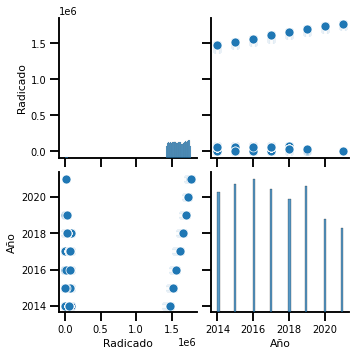

In [34]:
sns.pairplot(df_new[['Radicado', 'Año']])

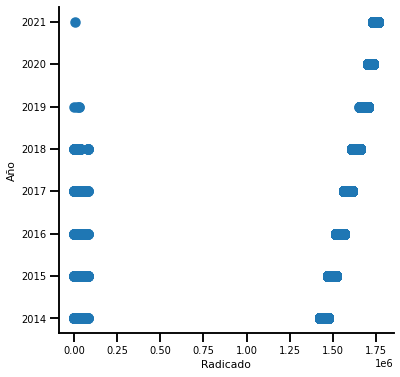

In [35]:
plt.figure(figsize=(6,6))
plt.scatter(df_new['Radicado'], df_new['Año'])

plt.xlabel('Radicado')
plt.ylabel('Año')
sns.despine()

A través de los gráficos se puede apreciar que estas variables están muy correlacionadas y una puede ser representante de otra, por lo que desconsideraremos en esta oportunidad `Radicado`, ya que, si bien esta variable puede agrupar los individuos en el mismo incidente, nos gustaría centrarnos en características más particulares de cada individuo, en esta ocasión.

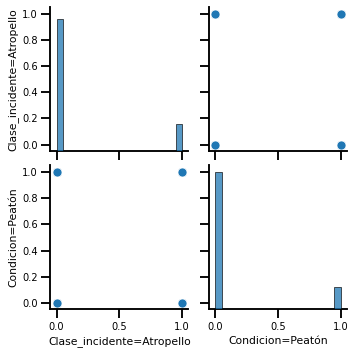

In [36]:
sns.pairplot(df_new[['Clase_incidente=Atropello', 'Condicion=Peatón']])

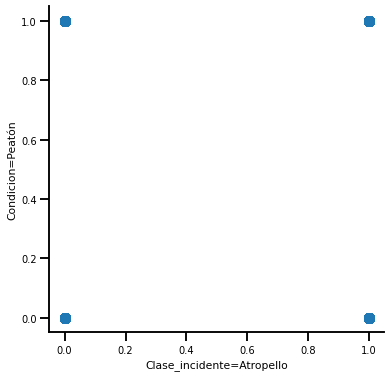

In [37]:
plt.figure(figsize=(6,6))
plt.scatter(df_new['Clase_incidente=Atropello'], df_new['Condicion=Peatón'])

plt.xlabel('Clase_incidente=Atropello')
plt.ylabel('Condicion=Peatón')
sns.despine()

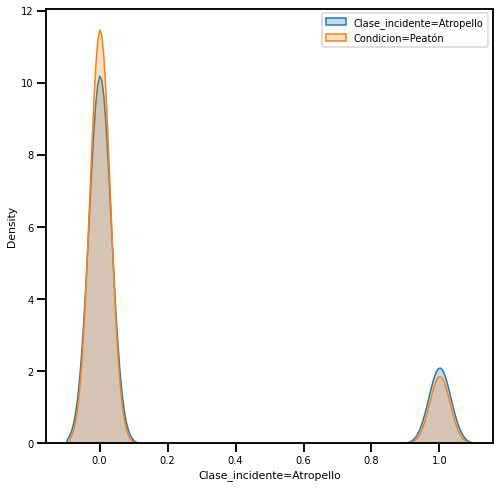

In [38]:
plt.figure(figsize=(8,8))
sns.kdeplot(df_new['Clase_incidente=Atropello'], shade=True, cbar=True)
sns.kdeplot(df_new['Condicion=Peatón'], shade=True, cbar=True)

plt.legend(labels=['Clase_incidente=Atropello', 'Condicion=Peatón'])
plt.show()

A través de los gráficos podemos ver que estas variables poseen una distribución en la cual predomina cierto grupo de ejemplos, debido al desbalanceo original que conocemos de Gravedad_Victima. A su vez, ambas distribuciones son muy parecidas, por lo que, consideraremos una de estas dos, en este caso `Clase_incidente=Atropello`. 

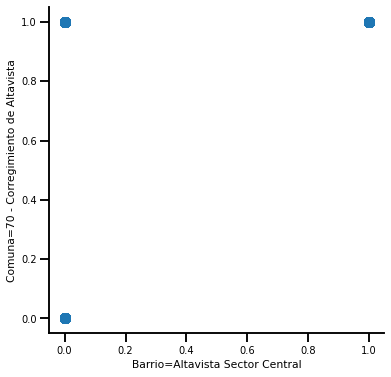

In [39]:
plt.figure(figsize=(6,6))

plt.scatter(df_new['Barrio=Altavista Sector Central'], df_new['Comuna=70 - Corregimiento de Altavista'])

plt.xlabel('Barrio=Altavista Sector Central')
plt.ylabel('Comuna=70 - Corregimiento de Altavista')
sns.despine()
plt.show()

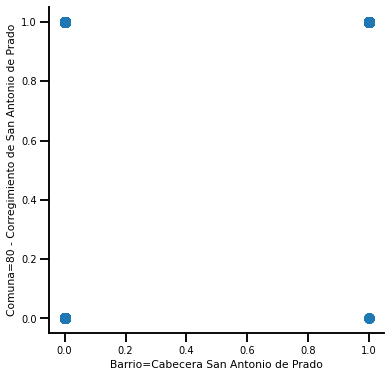

In [40]:
plt.figure(figsize=(6,6))

plt.scatter(df_new['Barrio=Cabecera San Antonio de Prado'], df_new['Comuna=80 - Corregimiento de San Antonio de Prado'])

plt.xlabel('Barrio=Cabecera San Antonio de Prado')
plt.ylabel('Comuna=80 - Corregimiento de San Antonio de Prado')
sns.despine()
plt.show()

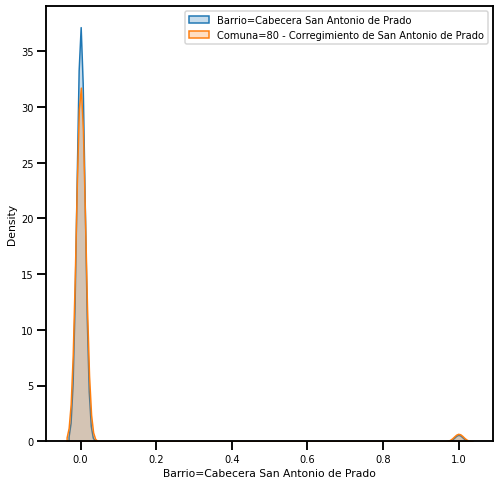

In [41]:
plt.figure(figsize=(8,8))
sns.kdeplot(df_new['Barrio=Cabecera San Antonio de Prado'], shade=True, cbar=True)
sns.kdeplot(df_new['Comuna=80 - Corregimiento de San Antonio de Prado'], shade=True, cbar=True)

plt.legend(labels=['Barrio=Cabecera San Antonio de Prado', 'Comuna=80 - Corregimiento de San Antonio de Prado'])
plt.show()

Se observa que en ambos casos de barrio y comuna sucede de forma análoga a el caso de `Clase_incidente=Atropello` y `Condicion=Peatón`, en el sentido de que sus distribuciones son similares. Consideraremos en este caso a las comunas `Comuna=70 - Corregimiento de Altavista` y a `Comuna=80 - Corregimiento de San Antonio de Prado`.

In [42]:
df_new = df_new.drop([
    'Radicado', 
    'Condicion=Peatón',
    'Barrio=Altavista Sector Central',
    'Barrio=Cabecera San Antonio de Prado'
], axis=1)

## 3. Técnicas de clustering y 4. Evaluación

La agrupación en clústeres es una técnica de aprendizaje automático no supervisada que divide a la población en varios clústeres o grupos de tal manera que los puntos de datos en un clúster son similares entre sí y los puntos de datos en diferentes clústeres son diferentes. 


### Mezcla de Gaussianas en subpoblación


El algoritmo GMM (mezcla gaussiana) permite determinar los distintos clústeres separando los datos contenidos en las distintas curvas con forma de campana. 

El algoritmo determina una media y una varianza para cada clúster y después determina una probabilidad de pertenecer o no a ese clúster para cada observación.

> Ya que solo usaremos Latitud y Longitud, usaremos las originales para proporcionar mayor realidad geográfica.

In [ ]:
df_geo = df.copy()

En general, cuanto mayor sea la puntuación de Silhouette, mejor definidos estarán sus grupos. 

In [ ]:
# Select data for clustering model
X = df_geo[['Longitud', 'Latitud']]

# Set the model and its parameters - 5 clusters
model5 = GaussianMixture(n_components=5, # this is the number of clusters
                         covariance_type='full', # {‘full’, ‘tied’, ‘diag’, ‘spherical’}, default=’full’
                         max_iter=100, # the number of EM iterations to perform. default=100
                         n_init=1, # the number of initializations to perform. default = 1
                         init_params='kmeans', # the method used to initialize the weights, the means and the precisions. {'random' or default='k-means'}
                         verbose=0, # default 0, {0,1,2}
                         random_state=1 # for reproducibility
                        )

# Fit the model and predict labels
clust5 = model5.fit(X)
labels5 = model5.predict(X)

# Print model summary
print('*************** 5 Cluster Model ***************')
#print('Weights: ', clust5.weights_)
print('Means: ', clust5.means_)
print('Covariances: ', clust5.covariances_)
#print('Precisions: ', clust5.precisions_)
#print('Precisions Cholesky: ', clust5.precisions_cholesky_)
#print('Converged: ', clust5.converged_)
print(' No. of Iterations: ', clust5.n_iter_)
#print('Lower Bound: ', clust5.lower_bound_)

*************** 5 Cluster Model ***************
Means:  [[-75.58352531   6.21892726]
 [-75.56621527   6.25009354]
 [-75.60084401   6.25963018]
 [-75.65897131   6.18760155]
 [-75.56653814   6.28604425]]
Covariances:  [[[ 1.71373154e-04 -6.40174293e-05]
  [-6.40174293e-05  2.25349092e-04]]

 [[ 1.71749805e-04 -2.96249060e-05]
  [-2.96249060e-05  1.55089089e-04]]

 [[ 2.33293165e-04 -1.25259012e-05]
  [-1.25259012e-05  2.65028407e-04]]

 [[ 5.91273728e-04 -4.37631315e-04]
  [-4.37631315e-04  3.44934246e-04]]

 [[ 1.76410853e-04 -3.37014110e-06]
  [-3.37014110e-06  1.66721792e-04]]]
 No. of Iterations:  5


Agregamos la columna de clusters al dataframe

In [ ]:
df_geo['Clust5'] = labels5

In [ ]:
df_geo.head(5)

,Gravedad_victima,Clase_incidente,Sexo,Edad,Condicion,Mes,Dia,Num_dia,Hora,Año,Radicado,Latitud,Longitud,Comuna,Barrio,Clust5
0,Heridos,Otro,M,17.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423940.0,6.266915,-75.559099,04 - Aranjuez,Manrique Central No. 1,1
1,Heridos,Atropello,M,20.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2,4
2,Heridos,Atropello,F,18.0,Peatón,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2,4
3,Heridos,Atropello,M,19.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes,0
4,Heridos,Atropello,M,39.0,Peatón,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes,0


In [ ]:
df_geo['Clust5'].value_counts()

1    73227
4    60324
0    41860
2    31964
3     4480
Name: Clust5, dtype: int64

In [ ]:
# Armamos una crosstable con el porcentaje de los registros asociados a cada cluster creado por KMeans
cross = pd.crosstab(df_geo.Clust5, df_geo.Gravedad_victima, normalize="index")
cross

Gravedad_victima,Heridos,Muertos
Clust5,,
0,0.992499,0.007501
1,0.991219,0.008781
2,0.992930,0.007070
3,0.977455,0.022545
4,0.992706,0.007294


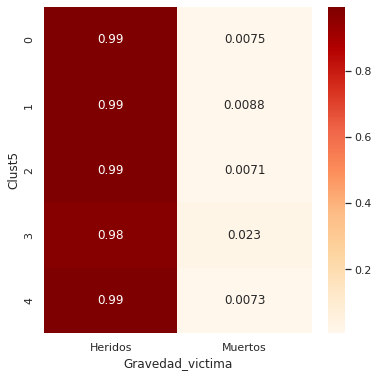

In [ ]:
# Armamos un grafico para saber porcentualmente como se distribuyen los registros de las cuatro posiciones en los distintos cluster
plt.figure(figsize=(6,6))
sns.heatmap(cross, annot=True, cmap = "OrRd")

> Para que `Gravedad_victima==Muertos` no genere una distorción en los graficos, tomaremos la subpoblación de `Gravedad_victima==Heridos`, por lo cual eliminamos los registros de Gravedad_victima==Muertos


In [ ]:
df_geo.drop(df_geo.loc[df_geo['Gravedad_victima']=='Muertos'].index, inplace=True)

In [ ]:
df_geo.head(5)

,Gravedad_victima,Clase_incidente,Sexo,Edad,Condicion,Mes,Dia,Num_dia,Hora,Año,Radicado,Latitud,Longitud,Comuna,Barrio,Clust5
0,Heridos,Otro,M,17.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423940.0,6.266915,-75.559099,04 - Aranjuez,Manrique Central No. 1,1
1,Heridos,Atropello,M,20.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2,4
2,Heridos,Atropello,F,18.0,Peatón,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2,4
3,Heridos,Atropello,M,19.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes,0
4,Heridos,Atropello,M,39.0,Peatón,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes,0


##### Gráfico geolocalizador

In [ ]:
token = 'pk.eyJ1IjoidmdhcmllbCIsImEiOiJjbDNkNTkzYWswMDJhM2lxczlndzk5YjBmIn0.CQG2v9YCWN3ABAi_gJNG1Q'

fig = go.Figure(go.Scattermapbox(
                lon = df_geo['Longitud'],
                lat = df_geo['Latitud'],
                mode = "markers+text",
                marker = go.scattermapbox.Marker(size = df_geo['Clust5'],
                                                 color = df_geo['Clust5'],
                                                 colorscale = 'inferno',
                                                 showscale = True,
                                                 sizemode = 'diameter',
                                                 opacity = 0.8),
hoverinfo = 'text',
hovertext = '<b>Comuna</b>: ' + df_geo['Comuna'].astype(str) + '<br>'
            '<b>Tipo de Incidentes</b>: ' + df_geo['Clase_incidente'].astype(str) + '<br>'))

fig.update_layout(
    hovermode='x',
    margin = dict(r=0, l=0, b=0, t=0),
    mapbox = dict(accesstoken=token, style='stamen-terrain', 
                  zoom=10, center=dict(lat=6.24659, lon= -75.57967)),
    showlegend = True,
    autosize = True                
)

In [ ]:
#En Colab:
fig.show(renderer="colab")

En el mapa geográfico se muestra a Medellín clusterizada con la subpoblación de Heridos.

El **cluster naranja** representa a la comuna `80 - Corregimiento de San Antonio de Prado`.

En los clusters restantes se puede ver que pertenecen a cada uno distinto grupo de comunas.

Las distintas clase de incidente, al menos a simple vista se ve presentada en todos los clusters, salvo por `Incendio` que recordamos que era la menos frecuente y tenía muy pocas ocurrencias.


### Normalización

> ¿Es necesaria la normalización de los datos? Si normalizas los datos, se alteran los resultados de los hiperparámetros? **Tener en cuenta que normalizar en este caso quiere decir escalar, estandarizar o normalizar.**

Muchos algoritmos de aprendizaje automático funcionan mejor cuando las características están en una escala relativamente similar y cerca de la distribución normal. A su vez, convergen más rápido cuando las características están en una escala relativamente similar y/o cerca de la distribución normal. 

Por eso se recomienda pre-procesar los datos de alguna u ambas formas, cuando un algoritmo de aprendizaje automático dependa de la distancia relativa de las observaciones, como es el caso de varios **algoritmos de clustering como K-Means, DBSCAN y GMM**, o que use la regularización L2. Por ejemplo, K-Means, que utiliza la distancia Euclediana o L2 lo necesita (más 
[KMeans-norm-solo-numericas](https://www.quora.com/Should-you-standardize-binary-categorical-and-indicator-primary-key-variables-before-performing-K-means-clustering)).

El escalado y la estandarización pueden ayudar a que las características lleguen en una forma más digerible para estos algoritmos. 

`PCA` (embedding análisis de componentes principales) y `KNN` (vecinos más cercanos), algoritmos que su vez probablemente utilizaremos, también lo necesitan.

Al entrenar la instancia de la clase PCA, sklearn se encarga de centrar los datos restandoles la media. Sin embargo, es recomendable también estandarizar o al menos escalar la matriz original para asegurar de que todas las variables estén en las mismas unidades y ninguna tenga un peso demasiado grande.

En el caso de usar las características de coordenadas, como el caso anterior que hicimos de **GMM**, no haría falta escalar o estandarizar, ya que no se representaría en el mapa los valores reales de localización.


> Veamos las columnas numéricas posibles a procesar

In [43]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211855 entries, 0 to 211854
Columns: 406 entries, Gravedad_victima=Heridos to Dia
dtypes: float64(406)
memory usage: 656.2 MB


In [44]:
num_cols = ['Edad', 'Num_dia', 'Hora', 'Latitud', 'Longitud']
num_cols

['Edad', 'Num_dia', 'Hora', 'Latitud', 'Longitud']

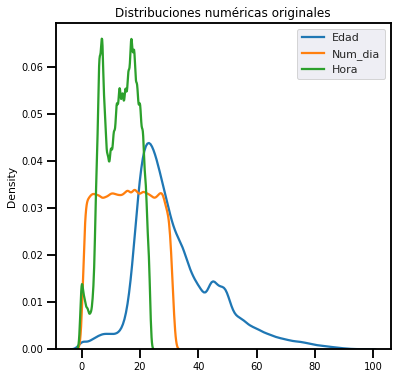

In [45]:
plt.figure(figsize=(6, 6))
sns.kdeplot(df_new['Edad'], cbar=True);
sns.kdeplot(df_new['Num_dia'], cbar=True);
sns.kdeplot(df_new['Hora'], cbar=True);
#sns.kdeplot(df_new['Latitud'], cbar=True);
#sns.kdeplot(df_new['Longitud'], cbar=True);
sns.set(rc = {'figure.figsize': (12,10)})
plt.title('Distribuciones numéricas originales')
plt.xlabel('')
plt.legend(labels=num_cols)
plt.show()

Se observa sólo con las distribuciones de algunas variables, que se necesita al menos escalar estas columnas, debido a que tienen escalas bastante distintas.

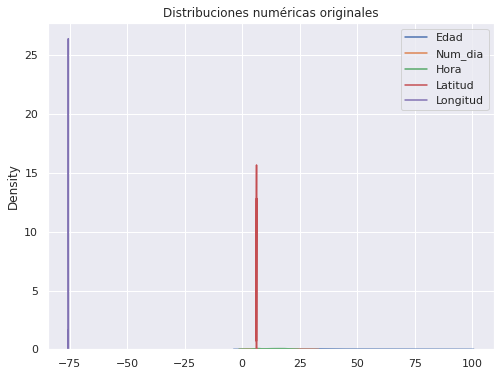

In [46]:
plt.figure(figsize=(8, 6))
sns.kdeplot(df_new['Edad'], cbar=True);
sns.kdeplot(df_new['Num_dia'], cbar=True);
sns.kdeplot(df_new['Hora'], cbar=True);
sns.kdeplot(df_new['Latitud'], cbar=True);
sns.kdeplot(df_new['Longitud'], cbar=True);
sns.set(rc = {'figure.figsize': (12,10)})
plt.title('Distribuciones numéricas originales')
plt.xlabel('')
plt.legend(labels=num_cols)
plt.show()

Usaremos `MinMaxScaler` ya que las columnas Latitud y Longitud no nos conviene estandarizar porque se elimina su concepto geolocalizador. 

Además, las categóricas también solamente las escalaremos porque, si bien no hay drama con estandarizarlas, si están muy desbalanceadas, como pasa cuando hay muchas clases, que cada una tiene pocas ocurrencias, la distribución queda muy sesgada.

> Escalamos todo el dataframe

In [47]:
scaled = MinMaxScaler(feature_range=(-1, 1))
all_scaled = scaled.fit_transform(df_new)
np.max(all_scaled), np.min(all_scaled)

(1.0, -1.0)

In [48]:
# Pasamos el resultado de el escalado al data frame que usaremos
df_all_sc = pd.DataFrame(all_scaled, columns=df_new.columns)

In [49]:
df_all_sc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211855 entries, 0 to 211854
Columns: 406 entries, Gravedad_victima=Heridos to Dia
dtypes: float64(406)
memory usage: 656.2 MB


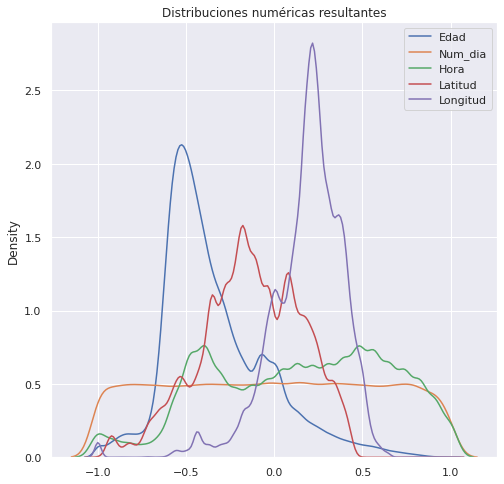

In [50]:
plt.figure(figsize=(8, 8))
sns.kdeplot(df_all_sc['Edad'], cbar=True);
sns.kdeplot(df_all_sc['Num_dia'], cbar=True);
sns.kdeplot(df_all_sc['Hora'], cbar=True);
sns.kdeplot(df_all_sc['Latitud'], cbar=True);
sns.kdeplot(df_all_sc['Longitud'], cbar=True);
sns.set(rc = {'figure.figsize': (12,10)})
plt.title('Distribuciones numéricas resultantes')
plt.xlabel('')
plt.legend(labels=num_cols)
plt.show()

### K-Means


`k-Means` es un popular algoritmo de agrupamiento basado en el centroide, que divide los puntos de datos de toda la población en k grupos, cada uno con una cantidad casi igual de puntos de datos. La idea detrás del algoritmo de agrupamiento k-Means es encontrar k-puntos centroides y cada punto en el conjunto de datos pertenecerá a cualquiera de los k-conjuntos que tengan una distancia euclidiana mínima.

##### Preparación de datos

Ya que `Gravedad_victima` sabemos que está desbalanceada, eliminamos esta variable de nuestro Data Set para ver el comportamiento de K-Means al generar los clusters.

In [110]:
df_all_sc_train = df_all_sc.drop([
    'Gravedad_victima=Heridos', 
    'Gravedad_victima=Muertos'
], axis=1)

##### Analisis de Codo

CPU times: user 4min 33s, sys: 7.17 s, total: 4min 40s
Wall time: 2min 35s


Text(0.5, 1.0, 'Inertia of k-Means versus number of clusters')

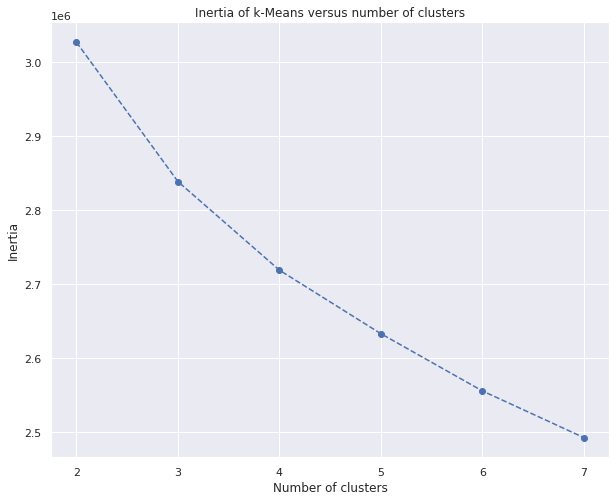

In [111]:
# Analisis para determinar el hiperparámetro n_clusters, variando de 2 a 8 clusters
%%time
scores = [KMeans(n_clusters=i).fit(df_all_sc_train).inertia_ for i in range(2,8)]

plt.figure(figsize=(10,8))
plt.plot(np.arange(2, 8), scores, marker='o', linestyle='--')
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("Inertia of k-Means versus number of clusters")

##### Aplicamos KMeans

In [112]:
%%time
# Número de clusters definido por el metodo del codo
clusters = 4

km = KMeans(n_clusters=clusters)
km.fit(df_all_sc_train)

CPU times: user 40 s, sys: 1.15 s, total: 41.2 s
Wall time: 22.1 s


KMeans(n_clusters=4)

In [113]:
# Diferentes clusters asignadas a cada incidente
clusters = km.labels_

In [114]:
centroides = km.cluster_centers_

In [115]:
df_KMeans = df.copy()
df_KMeans['clusters'] = clusters
df_KMeans.head(5)

,Gravedad_victima,Clase_incidente,Sexo,Edad,Condicion,Mes,Dia,Num_dia,Hora,Año,Radicado,Latitud,Longitud,Comuna,Barrio,clusters
0,Heridos,Otro,M,17.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423940.0,6.266915,-75.559099,04 - Aranjuez,Manrique Central No. 1,0
1,Heridos,Atropello,M,20.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2,1
2,Heridos,Atropello,F,18.0,Peatón,Ene,Mié,1.0,0.0,2014,1423921.0,6.289353,-75.553292,01 - Popular,Moscú No. 2,1
3,Heridos,Atropello,M,19.0,Motociclista,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes,1
4,Heridos,Atropello,M,39.0,Peatón,Ene,Mié,1.0,0.0,2014,1423849.0,6.234327,-75.607611,16 - Belén,Las Mercedes,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211850,Heridos,Otro,F,44.0,Motociclista,Sept,Jue,30.0,20.0,2021,1763939.0,6.298268,-75.585992,06 - Doce de Octubre,Picachito,2
211851,Heridos,Choque,F,38.0,Motociclista,Sept,Jue,30.0,20.0,2021,1763788.0,6.217895,-75.575824,14 - El Poblado,Villa Carlota,2
211852,Heridos,Otro,M,32.0,Motociclista,Sept,Jue,30.0,22.0,2021,1764135.0,6.234267,-75.536311,08 - Villa Hermosa,Las Estancias,0
211853,Heridos,Otro,F,29.0,Acompañante de Motocicleta,Sept,Jue,30.0,22.0,2021,1764135.0,6.234267,-75.536311,08 - Villa Hermosa,Las Estancias,2


**Coeficiente de silueta**

El coeficiente de silueta es una métrica utilizada para calcular la bondad de una técnica de agrupación. 

El mejor valor es 1 y el peor valor es -1. 

Los valores cercanos a 0 indican clústeres superpuestos. 

Los valores negativos generalmente indican que una muestra se ha asignado al conglomerado equivocado, ya que un conglomerado diferente es más similar.

In [117]:
# Corremos silhouette 
%%time
silhouette_score = silhouette_score(df_all_sc_train, clusters, metric='euclidean')
silhouette_score

CPU times: user 37min 12s, sys: 52.5 s, total: 38min 4s
Wall time: 22min 51s


0.09755892164808573

##### Analisis del Data Frame

In [116]:
# Cantidad de registros asociados a cada clusters
df_KMeans['clusters'].value_counts()

3    68097
0    54480
2    53042
1    36236
Name: clusters, dtype: int64

En este caso, los valores cercanos a 0 indican clústeres superpuestos. 

In [118]:
fig = px.scatter_3d(df_KMeans, x='Clase_incidente', y='Sexo', z='Mes',
              color='clusters')

In [119]:
#En Colab:
fig.show(renderer="colab")

*Apreciaciones:*

El **cluster 0** se corresponde con el sexo `Masculino` y `Sin Inf`, para las clases de incidente `Incendio`, `Volcamiento`, `Ocupante` y `Otro`, para todos los meses salvo `Mayo` en `Sin Inf` para `Volcamiento` y `Incendio`.

El **cluster 1** se representa por `Atropello` para todos los sexos y meses.

El **cluster 2** se representa por sexo `Femenino` para todas las clases de incidentes menos `Atropello`, y para `Sin Inf` en `Volcamiento`, `Caida_Ocupante` y `Choque`

Se puede apreciar que el **cluster 3** se presenta en `Choque` para los sexos `Femenino` y `Sin Inf` en todos los meses salvo `Septiembre` en el caso de `Sin Inf`.

-> `Choque` está representado por el cluster 3

-> `Incendio` está representado por el cluster 0 y tiene mayoría en sexo `Masculino` seguido de sexo Femenino.

In [120]:
kmean_clusters = go.Scatter(x=df_KMeans['Condicion'], y=df_KMeans['Sexo'],
                           mode='markers',
                           text=df_KMeans.loc[:,'Condicion'],
                           marker=dict(
                                size=5,
                                color = clusters.astype(np.float), #set color equal to a variable
                                colorscale='Portland',
                                showscale=False)
                           )

layout = go.Layout(title="Clustering K means ",titlefont=dict(size=20),
                xaxis=dict(title='Condicion'),
                yaxis=dict(title='Sexo'),
                autosize=False, width=1000,height=650)

fig = go.Figure(data=kmean_clusters, layout=layout)

In [ ]:
#En Colab:
# fig.show(renderer="colab")

### DB-Scan

DB-Scan fue creado para resolver un problema de agrupamiento diferente. Aísla los clústeres de alta densidad de los clústeres de baja densidad.

A diferencia de otros algoritmos de clustering como KMeans, DB-Scan resulta muy adecuado para buscar patrones de agrupación en el espacio físico. Por ejemplo, en la distribución espacial de actividades humanas. 

Entre varias alternativas DB-Scan es la única cuyos resultados aproximan los de un analista humano que estuviera clasificando puntos aglomerados en un mapa.

Hiperparámetros:
* `epsilon` es el radio de “vecindad” en torno a un punto.
* `minPts` es la cantidad mínima de vecinos dentro del radio epsilon que alcanzan para definir a ese punto como miembro de un cluster

Sin embargo, no es muy adecuado cuando los clústeres tienen densidades similares (ya que el algoritmo separa las densidades)
o cuando los datos tienen alta dimensionalidad ([fuente1](https://towardsdatascience.com/clustering-algorithms-a-one-stop-shop-6cd0959f9b8f), [fuente2](https://www.linkedin.com/pulse/dbscan-machine-learning-para-detectar-centros-de-vazquez-brust/?originalSubdomain=es)).

##### Calculo del Epsilon

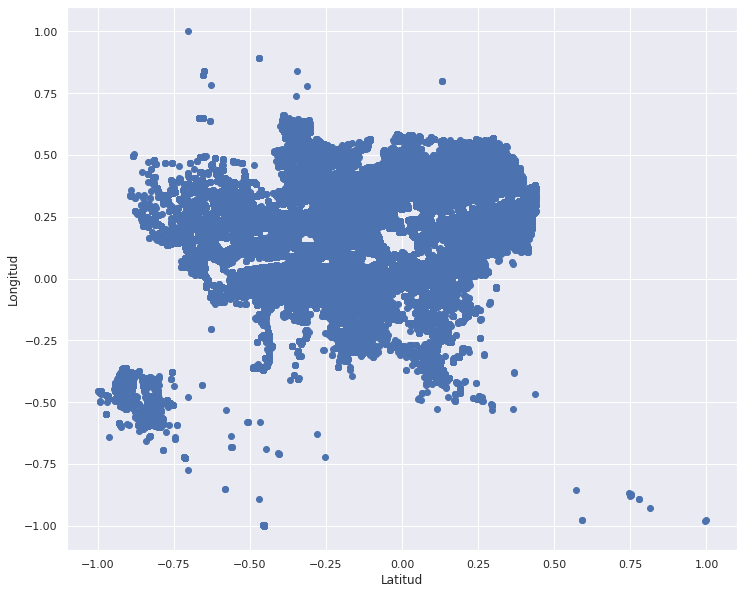

In [51]:
plt.scatter(df_all_sc.Latitud, df_all_sc.Longitud)
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

In [52]:
# Definimos las dos variables que vamos a analizar
df_knn = df_all_sc.copy()[['Latitud', 'Longitud']]

In [53]:
# Utilizamos el algoritmo de Vecinos mas cercanos KNN 
knn = NearestNeighbors(n_neighbors=5)
vecinos = knn.fit(df_knn)

# Calculamos la matriz de distancias de cada punto analizado (filas) respecto cada uno 
# de los vecinos mas cercanos (columnas) 
distancia, indices = vecinos.kneighbors(df_knn)

# Ordenamos las filas que forman la matriz del df_knn reducido de a dos variables
distancia = np.sort(distancia, axis=0)
print('Cantidad de puntos analisados que forman las dos varibales seleccionadas:',len(distancia))
print('\nMatriz de distancia de cada punto con respecto a los vecinos seleccionados\n', distancia)

Cantidad de puntos analisados que forman las dos varibales seleccionadas: 211855

Matriz de distancia de cada punto con respecto a los vecinos seleccionados
 [[0.         0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.        ]
 ...
 [0.         0.10846434 0.17021385 0.23051998 0.23052032]
 [0.         0.1205351  0.18804193 0.23706601 0.23706601]
 [0.         0.17021385 0.19064841 0.23915161 0.23915161]]


In [54]:
# De la matriz que calculamos anteriormente tomamos una columna para hacer el analisis del mejor EPSILON
columna = 3
distancia_vector = distancia[:,columna]
print('Datos de la columna de distancias seleccionada de la matriz\n', distancia_vector)

# Me armo el vector de elementos que toma todas las filas incluidas en la definicion de distancias
i = np.arange(len(distancia_vector))
print('\nCantidad de puntos analisados que forman las dos varibales seleccionadas\n', i)

Datos de la columna de distancias seleccionada de la matriz
 [0.         0.         0.         ... 0.23051998 0.23706601 0.23915161]

Cantidad de puntos analisados que forman las dos varibales seleccionadas
 [     0      1      2 ... 211852 211853 211854]


Text(0, 0.5, 'Distancia')

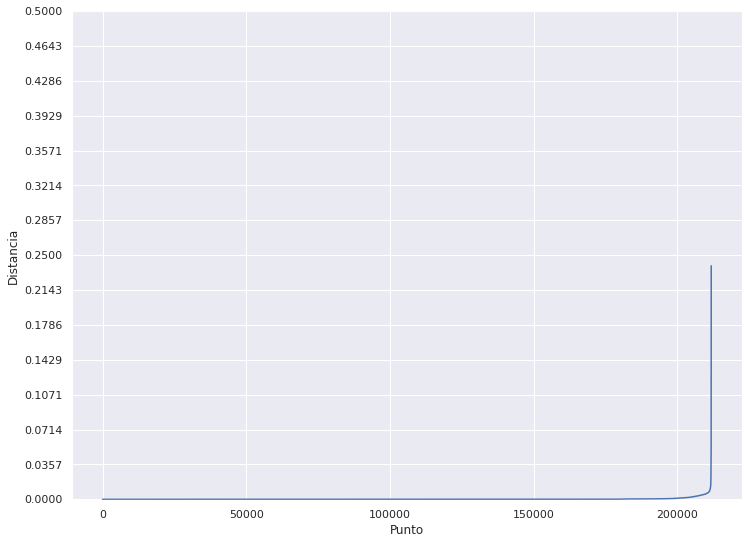

In [55]:
# Determinamos el Epsilon correcto en función de los dos vectores que armamos antes
# Para determinar el Epsilon aproximado tenemos que analizar el mayor quiebre que se produce en la gráfica 
plt.figure(figsize=(12,9))
yticks = np.linspace(0, 0.5, 15)
ax = sns.lineplot(x=i, y=distancia_vector)
ax.set_ylim(-0.001, 0.5)
ax.set_yticks(yticks)
plt.xlabel("Punto")
plt.ylabel("Distancia")

El `epsilon` parece estar entre 0.01 y 0.03.


##### Aplicamos DB-Scan

In [83]:
# más de 0.1 crashea en google colab porque supera la RAM de 12GB
X_train = df_knn[['Latitud', 'Longitud']].copy()

In [86]:
%%time
# más de 0.1 crashea en google colab porque supera la RAM de 12GB
X_train = df_knn[['Latitud', 'Longitud']].copy()
# entrenamiento
dbscan = DBSCAN(eps=0.02, min_samples=10).fit(X_train)
core_samples_mask = np.zeros_like(dbscan.labels_, dtype=bool)
core_samples_mask[dbscan.core_sample_indices_] = True
labels = dbscan.labels_

CPU times: user 9.45 s, sys: 1.19 s, total: 10.6 s
Wall time: 10.9 s


In [87]:
unique_labels = np.unique(labels)
unique_labels

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24])

> La etiqueta -1 quiere decir ruido



En un radio de epsilon a la redonda de un incidente dado, veremos que se encuentren al menos otros minPts = 4 incidentes.

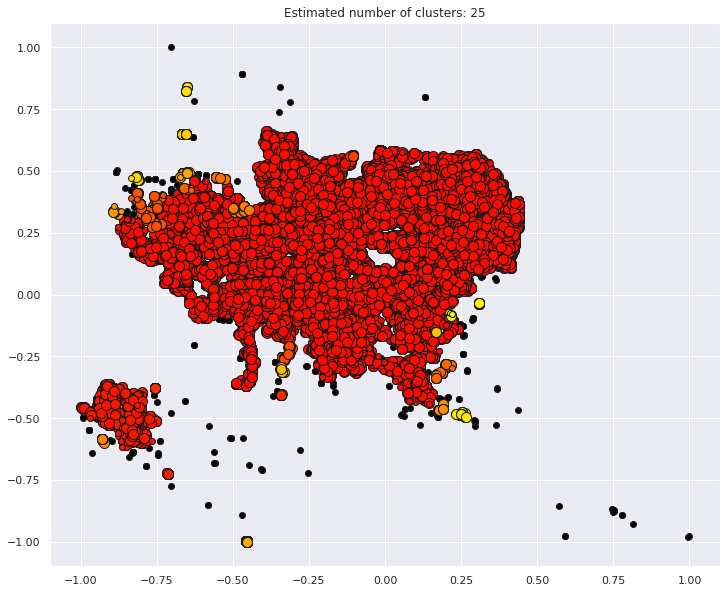

In [89]:
# calculamos el número de clusters
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
# calculamos el número de puntos con ruido
n_noise_ = list(labels).count(-1)
# creamos los colores
colors = [plt.cm.autumn(each)
          for each in np.linspace(0, 1, len(unique_labels))]

for k, col in zip(unique_labels, colors):
    if k == -1:
        # Usamos Negro para la etiqueta de ruido
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X_train[class_member_mask & core_samples_mask]
    plt.plot(xy['Latitud'], xy['Longitud'], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=10)

    xy = X_train[class_member_mask & ~core_samples_mask]
    plt.plot(xy['Latitud'], xy['Longitud'], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()


In [90]:
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Cantidad de clusters estimados: %d' % n_clusters_)
print('Cantidad de puntos con ruido estimados: %d' % n_noise_)

Cantidad de clusters estimados: 25
Cantidad de puntos con ruido estimados: 265


In [82]:
%%time
# Number of clusters in labels, ignoring noise if present.
print("Coeficiente de Silhouette: %0.3f"
      % silhouette_score(X_train, labels))

Cantidad de clusters estimados: 25
Cantidad de puntos con ruido estimados: 265
Coeficiente de Silhouette: -0.324
CPU times: user 10min 18s, sys: 40.3 s, total: 10min 58s
Wall time: 9min 5s


Vemos que el coeficiente de Silhoette para DB-Scan es, si bien es más cercano al 0 que al -1, es negativo, por lo cual concluimos, observando además el gráfico que se ha asignado de forma incorrecta ejemplos a los clusters.

### Embbeding con PCA

#### Proceso PCA

In [92]:
%%time
pca_all_sc = PCA(n_components=8)
scores_pca_all_sc = pca_all_sc.fit_transform(df_all_sc)

CPU times: user 13.6 s, sys: 1.58 s, total: 15.2 s
Wall time: 8.53 s


In [93]:
print("Principal components:\n{}".format(pca_all_sc.components_))
print("Explained variance:\n{}".format(pca_all_sc.explained_variance_))
print("Explained variance ratio:\n{}".format(pca_all_sc.explained_variance_ratio_))
scores_pca_all_sc.shape

Principal components:
[[ 1.19964259e-04 -1.19964259e-04  1.31896025e-01 ...  3.41460280e-03
  -5.26213260e-03  2.57181717e-03]
 [ 1.89236906e-03 -1.89236906e-03 -3.33318575e-01 ... -5.78104197e-03
   8.27394309e-03 -3.35937449e-03]
 [ 1.30111304e-02 -1.30111304e-02 -3.72314906e-01 ... -1.17541082e-02
   7.31056794e-03  1.19471633e-02]
 ...
 [ 5.44780048e-03 -5.44780048e-03 -2.63154326e-01 ...  1.00472980e-02
  -3.53115900e-02 -5.26686934e-03]
 [-2.41484488e-03  2.41484488e-03  4.10380158e-02 ...  7.73953906e-02
  -1.34178872e-01 -3.55382445e-02]
 [ 2.24445048e-03 -2.24445048e-03 -2.56879696e-02 ... -9.83564865e-04
   9.77673103e-01  5.20018389e-02]]
Explained variance:
[2.00049088 1.27432085 1.07018749 0.69246491 0.62198089 0.59690516
 0.4608469  0.42803068]
Explained variance ratio:
[0.1237469  0.07882728 0.06619995 0.04283468 0.03847466 0.03692352
 0.02850719 0.02647724]


(211855, 8)

Se observa que Explained variance ratio de PC1 es del 1.2%, mientras el correspondiente a la segunda componente explica el 0.78%, disminuyendo los porcentajes cuando se consideran las siguientes componentes como es esperado.

In [94]:
# Preparamos el data frame para la visualización entonces realizamos la union del dataframe
# con las componenters principales que se obtuvieron de PCA
component_names = ['PC1','PC2','PC3', 'PC4']
df_segm_pca_all_sc = df_all_sc.copy()
# Creamos columnas de las componentes principales
df_segm_pca_all_sc[component_names] = scores_pca_all_sc[:,:4]
df_segm_pca_all_sc

,Gravedad_victima=Heridos,Gravedad_victima=Muertos,Clase_incidente=Atropello,Clase_incidente=Caida Ocupante,Clase_incidente=Choque,Clase_incidente=Incendio,Clase_incidente=Otro,Clase_incidente=Volcamiento,Sexo=F,Sexo=M,Sexo=Sin Inf,Condicion=Acompañante de Motocicleta,Condicion=Ciclista,Condicion=Conductor,Condicion=Motociclista,Condicion=Pasajero,Comuna=01 - Popular,Comuna=02 - Santa Cruz,Comuna=03 - Manrique,Comuna=04 - Aranjuez,Comuna=05 - Castilla,Comuna=06 - Doce de Octubre,Comuna=07 - Robledo,Comuna=08 - Villa Hermosa,Comuna=09 - Buenos Aires,Comuna=10 - La Candelaria,Comuna=11 - Laureles Estadio,Comuna=12 - La América,Comuna=13 - San Javier,Comuna=14 - El Poblado,Comuna=15 - Guayabal,Comuna=16 - Belén,Comuna=50 - Corregimiento de San Sebastián de Palmitas,Comuna=60 - Corregimiento de San Cristóbal,Comuna=70 - Corregimiento de Altavista,Comuna=80 - Corregimiento de San Antonio de Prado,Comuna=90 - Corregimiento de Santa Elena,Barrio=1114,Barrio=1316,Barrio=1418,Barrio=1419,Barrio=1422,Barrio=1423,Barrio=1511,Barrio=1611,Barrio=1612,Barrio=1613,Barrio=813,Barrio=9004,Barrio=AUC1,...,Barrio=Terminal De Transporte,Barrio=Terminal de Transporte,Barrio=Toscana,Barrio=Travesías,Barrio=Trece de Noviembre,Barrio=Tricentenario,Barrio=Trinidad,Barrio=U.D. Atanasio Girardot,Barrio=U.P.B.,Barrio=Universidad De Antioquia,Barrio=Universidad Nacional,Barrio=Universidad de Antioquia,Barrio=Veinte De Julio,Barrio=Veinte de Julio,Barrio=Versalles No. 1,Barrio=Versalles No. 2,Barrio=Versalles No.1,Barrio=Versalles No.2,Barrio=Villa Carlota,Barrio=Villa Flora,Barrio=Villa Guadalupe,Barrio=Villa Hermosa,Barrio=Villa Liliam,Barrio=Villa Lilliam,Barrio=Villa Niza,Barrio=Villa Nueva,Barrio=Villa Turbay,Barrio=Villa del Socorro,Barrio=Villatina,Barrio=Volcana Guayabal,Barrio=Yarumalito,Barrio=Yolombo,Barrio=Área De Expansión Pajarito,Barrio=Área De Expansión San Antonio De Prado,Barrio=Área de Expansión Altavista,Barrio=Área de Expansión Altos de Calasanz,Barrio=Área de Expansión Pajarito,Barrio=Área de Expansión San Antonio de Prado,Edad,Num_dia,Hora,Año,Latitud,Longitud,Mes,Dia,PC1,PC2,PC3,PC4
0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.649485,-1.000000,-1.000000,-1.0,-0.006905,0.355512,0.333333,-0.454545,-1.201778,-1.185222,1.003228,-0.217509
1,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.587629,-1.000000,-1.000000,-1.0,0.215780,0.409876,0.333333,-0.454545,-0.842084,-1.358747,-0.451053,0.598423
2,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.628866,-1.000000,-1.000000,-1.0,0.215780,0.409876,0.333333,-0.454545,2.411194,-0.936403,-0.464500,0.717768
3,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1

In [95]:
df_segm_pca_all_sc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211855 entries, 0 to 211854
Columns: 410 entries, Gravedad_victima=Heridos to PC4
dtypes: float64(410)
memory usage: 662.7 MB


#### Análisis visual PCA

##### Proyección 2D

Text(0, 0.5, 'Componente 2')

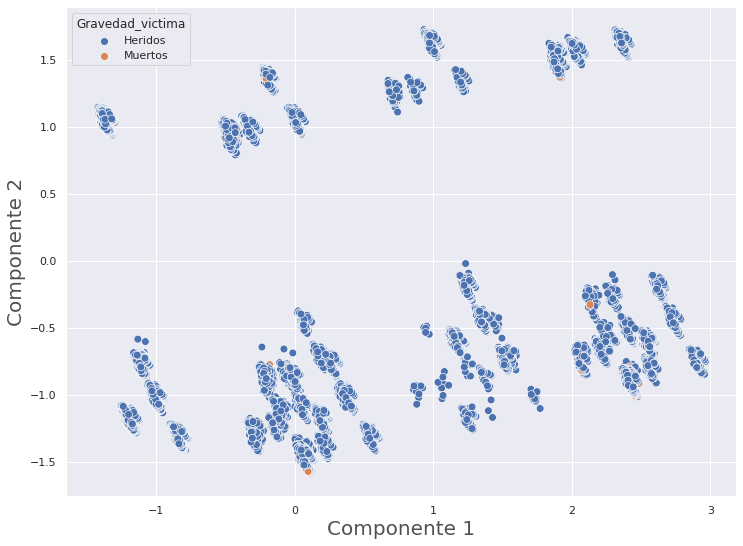

In [ ]:
# Graficamos la distribución del calculo generada por el PCA
plt.figure(figsize=(12,9))
sns.scatterplot(x=scores_pca_all_sc[:,0], y=scores_pca_all_sc[:,1], 
                hue=df['Gravedad_victima'], legend='full', s=60);

plt.xlabel("Componente 1", size=20, color='#505050')
plt.ylabel("Componente 2", size=20, color='#505050')

En este gráfico se nota el desbalance que habíamos encontrado en `Gravedad_victima`.

Text(0, 0.5, 'Componente 2')

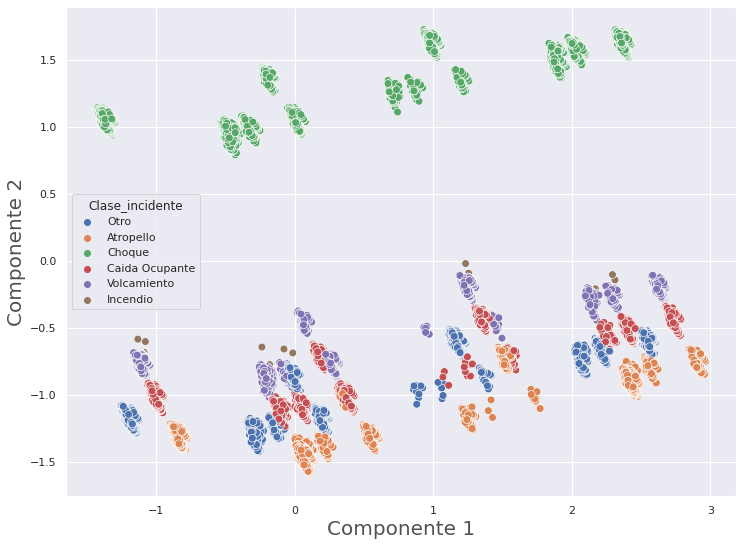

In [ ]:
# Graficamos la distribución del calculo generada por el PCA
plt.figure(figsize=(12,9))
sns.scatterplot(x=scores_pca_all_sc[:,0], y=scores_pca_all_sc[:,1], 
                hue=df['Clase_incidente'], legend='full', s=60);

plt.xlabel("Componente 1", size=20, color='#505050')
plt.ylabel("Componente 2", size=20, color='#505050')

Se observa en estas dos componentes como las victimas de `Choque` se encuentran bastantes diferenciadas del resto del tipo de incidentes, siendo `Atropello` la más disimil a esta. El resto se encuentran bastante agrupadas. 

`Incendio` se encuentra bastante cercana a `Volcamiento`. Ituimos que puede deberse a ser una consecuencia del `Volcamiento`.

Text(0, 0.5, 'Componente 2')

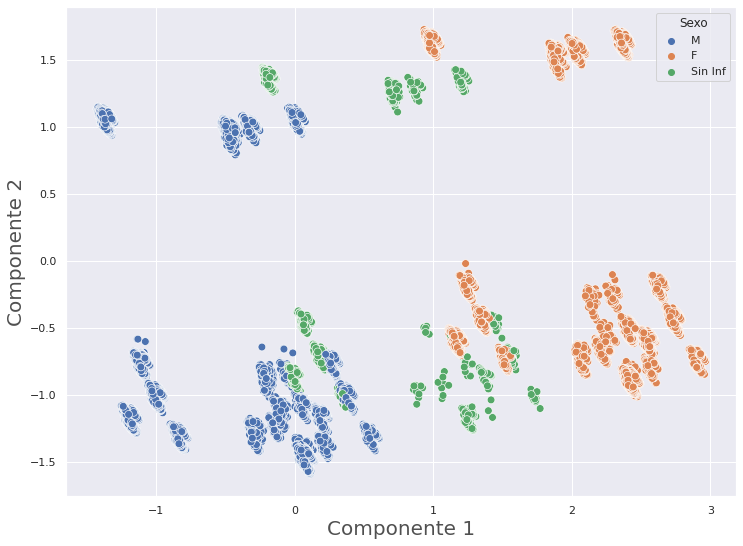

In [ ]:
# Graficamos la distribución del calculo generada por el PCA
plt.figure(figsize=(12,9))
sns.scatterplot(x=scores_pca_all_sc[:,0], y=scores_pca_all_sc[:,1], 
                hue=df['Sexo'], legend='full', s=60);

plt.xlabel("Componente 1", size=20, color='#505050')
plt.ylabel("Componente 2", size=20, color='#505050')

Acá se puede apreciar como se forman grupos bastante separados en cuanto al sexo de víctimas, al menos entre `Masculino` y `Femenino`. `Sin Inf` se nota mezclado con el resto de los sexos que aparecen. 

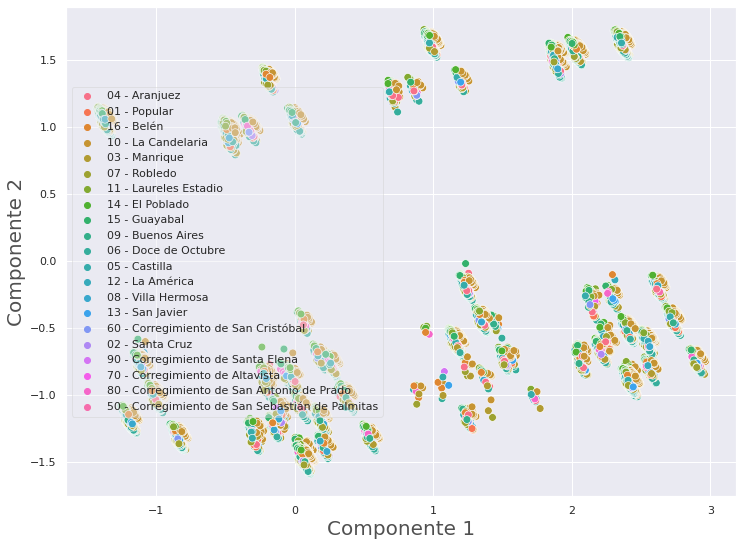

In [ ]:
# Graficamos la distribución del calculo generada por el PCA
plt.figure(figsize=(12,9))
sns.scatterplot(x=scores_pca_all_sc[:,0], y=scores_pca_all_sc[:,1], 
                hue=df['Comuna'], s=60);

plt.xlabel("Componente 1", size=20, color='#505050')
plt.ylabel("Componente 2", size=20, color='#505050')
plt.legend(loc="center left", framealpha=0.4)

Aquí para `Comuna` no se puede hacer ninguna distición a simple vista.

Text(0, 0.5, 'Componente 2')

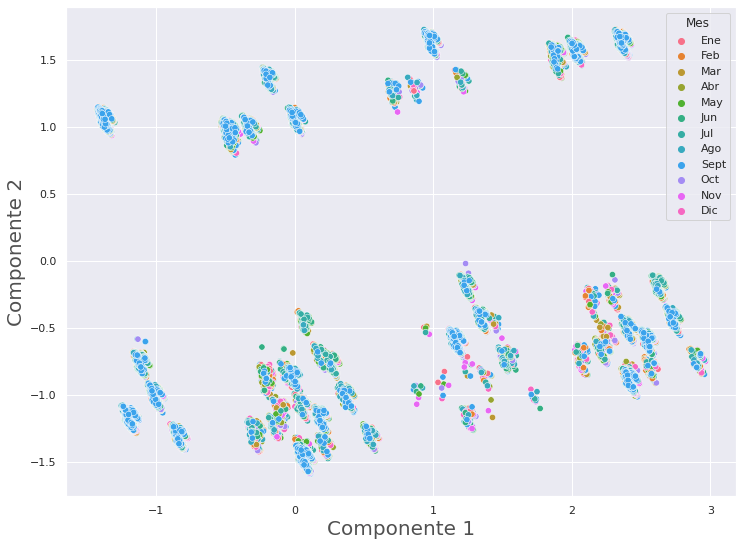

In [ ]:
# Graficamos la distribución del calculo generada por el PCA
plt.figure(figsize=(12,9))
sns.scatterplot(x=scores_pca_all_sc[:,0], y=scores_pca_all_sc[:,1], 
                hue=df['Mes'], legend='full', s=40);

plt.xlabel("Componente 1", size=20, color='#505050')
plt.ylabel("Componente 2", size=20, color='#505050')

Acá se puede apreciar como predomina el mes `Septiembre`, que ya hemos encontrado en AyVD que era uno de los dos más frecuentes en las incidentes.

Text(0, 0.5, 'Componente 3')

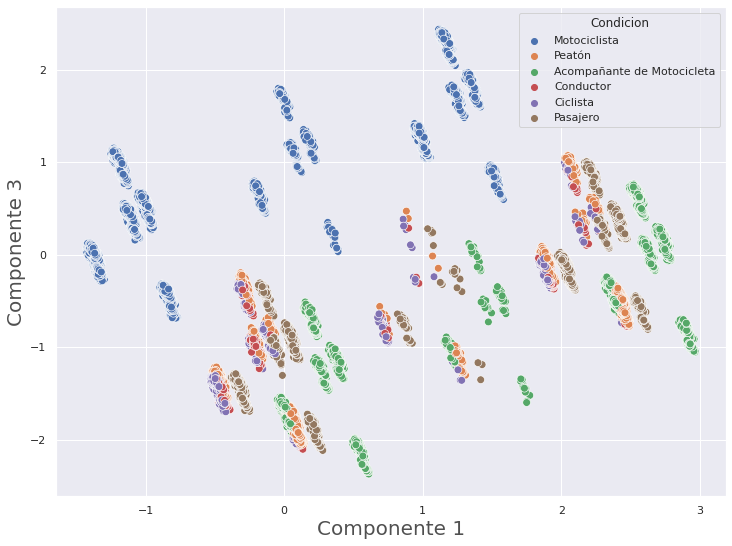

In [ ]:
# Graficamos la distribución del calculo generada por el PCA
plt.figure(figsize=(12,9))
sns.scatterplot(x=scores_pca_all_sc[:,0], y=scores_pca_all_sc[:,2], 
                hue=df['Condicion'], legend='full', s=60);


plt.xlabel("Componente 1", size=20, color='#505050')
plt.ylabel("Componente 3", size=20, color='#505050')

Se aprecia en la proyección de la Componente 1 y la Componente 3, la separación de `Motociclista` con el resto.

##### Proyección 3D

In [96]:
# Keep the 'clase_incidente'' column appart + make it numeric for coloring (needing)
df['clase_incidente'] = pd.Categorical(df['Clase_incidente'])
my_color = df['clase_incidente'].cat.codes
df = df.drop('clase_incidente', 1)

principalDf = pd.DataFrame(data=scores_pca_all_sc[:,:3],
              columns = ['PC1', 'PC2', 'PC3'])

fig = px.scatter_3d(principalDf, x='PC1', y='PC2', z='PC3',
              color=my_color)

In [97]:
#En Colab:
fig.show(renderer="colab")

#### KMeans con PCA

##### Analisis de Codo

Text(0.5, 1.0, 'K-Means  with PCA')

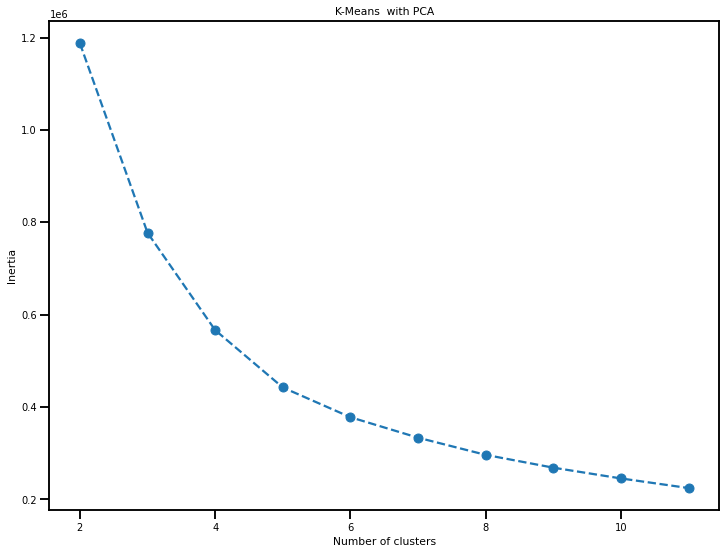

In [ ]:
# Analisis para determinar el hiperparámetro n_clusters
scores = [KMeans(n_clusters=i, init='k-means++', random_state=42)\
          .fit(scores_pca_all_sc).inertia_ for i in range(2,8)]

plt.figure(figsize=(12,9))
plt.plot(np.arange(2, 8), scores, marker='o', linestyle='--')
plt.xlabel('Number of clusters')
plt.ylabel("Inertia")
plt.title("K-Means  with PCA")

##### K-Means Optimo

In [ ]:
# Clustering K-Means sobre el array score_pca que obtubimos resultado de 
# aplicar PCA en data frame estandarizado sin nulos df_train
kmeans_pca = KMeans(n_clusters=4, init='k-means++', random_state=42)
kmeans_pca.fit(df_segm_pca_all_sc)

KMeans(n_clusters=4, random_state=42)

In [ ]:
# Del tata frame que armamos con los resultados del PCS vamos a realizar una copia para trabajar los clusters de KMean  
df_segm_pca_kmeans = df_segm_pca_all_sc.copy()

# Al data frame que armamos con los resultados de PCA le agrego la columna de los clusters que sale del analisis de KMeans
df_segm_pca_kmeans['KMeans_PCA'] = kmeans_pca.labels_

df_segm_pca_kmeans

,Gravedad_victima=Heridos,Gravedad_victima=Muertos,Clase_incidente=Atropello,Clase_incidente=Caida Ocupante,Clase_incidente=Choque,Clase_incidente=Incendio,Clase_incidente=Otro,Clase_incidente=Volcamiento,Sexo=F,Sexo=M,Sexo=Sin Inf,Condicion=Acompañante de Motocicleta,Condicion=Ciclista,Condicion=Conductor,Condicion=Motociclista,Condicion=Pasajero,Comuna=01 - Popular,Comuna=02 - Santa Cruz,Comuna=03 - Manrique,Comuna=04 - Aranjuez,Comuna=05 - Castilla,Comuna=06 - Doce de Octubre,Comuna=07 - Robledo,Comuna=08 - Villa Hermosa,Comuna=09 - Buenos Aires,Comuna=10 - La Candelaria,Comuna=11 - Laureles Estadio,Comuna=12 - La América,Comuna=13 - San Javier,Comuna=14 - El Poblado,Comuna=15 - Guayabal,Comuna=16 - Belén,Comuna=50 - Corregimiento de San Sebastián de Palmitas,Comuna=60 - Corregimiento de San Cristóbal,Comuna=70 - Corregimiento de Altavista,Comuna=80 - Corregimiento de San Antonio de Prado,Comuna=90 - Corregimiento de Santa Elena,Barrio=1114,Barrio=1316,Barrio=1418,Barrio=1419,Barrio=1422,Barrio=1423,Barrio=1511,Barrio=1611,Barrio=1612,Barrio=1613,Barrio=813,Barrio=9004,Barrio=AUC1,...,Barrio=Terminal de Transporte,Barrio=Toscana,Barrio=Travesías,Barrio=Trece de Noviembre,Barrio=Tricentenario,Barrio=Trinidad,Barrio=U.D. Atanasio Girardot,Barrio=U.P.B.,Barrio=Universidad De Antioquia,Barrio=Universidad Nacional,Barrio=Universidad de Antioquia,Barrio=Veinte De Julio,Barrio=Veinte de Julio,Barrio=Versalles No. 1,Barrio=Versalles No. 2,Barrio=Versalles No.1,Barrio=Versalles No.2,Barrio=Villa Carlota,Barrio=Villa Flora,Barrio=Villa Guadalupe,Barrio=Villa Hermosa,Barrio=Villa Liliam,Barrio=Villa Lilliam,Barrio=Villa Niza,Barrio=Villa Nueva,Barrio=Villa Turbay,Barrio=Villa del Socorro,Barrio=Villatina,Barrio=Volcana Guayabal,Barrio=Yarumalito,Barrio=Yolombo,Barrio=Área De Expansión Pajarito,Barrio=Área De Expansión San Antonio De Prado,Barrio=Área de Expansión Altavista,Barrio=Área de Expansión Altos de Calasanz,Barrio=Área de Expansión Pajarito,Barrio=Área de Expansión San Antonio de Prado,Edad,Num_dia,Hora,Año,Latitud,Longitud,Mes,Dia,PC1,PC2,PC3,PC4,KMeans_PCA
0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.649485,-1.000000,-1.000000,-1.0,-0.006905,0.355512,0.333333,-0.454545,-1.201778,-1.185226,1.003248,-0.217404,1
1,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.587629,-1.000000,-1.000000,-1.0,0.215780,0.409876,0.333333,-0.454545,-0.842085,-1.358757,-0.451009,0.598532,3
2,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-0.628866,-1.000000,-1.000000,-1.0,0.215780,0.409876,0.333333,-0.454545,2.411194,-0.936413,-0.464457,0.717881,2
3,1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,...,-1.0,-

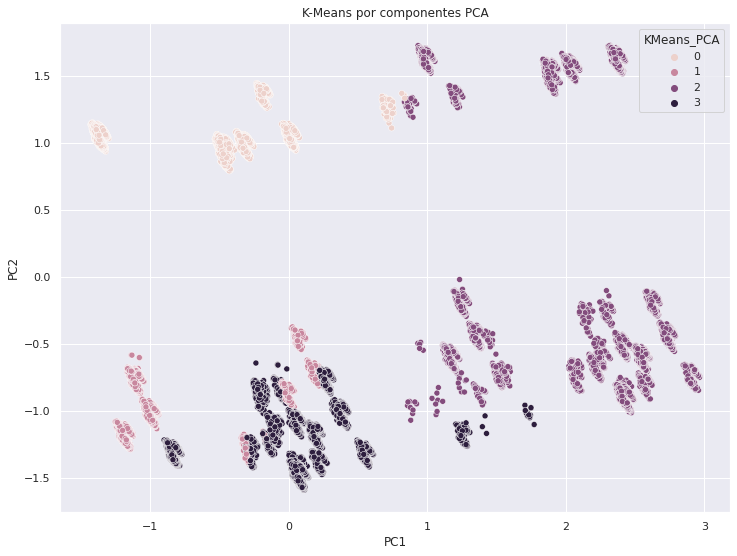

In [ ]:
plt.figure(figsize=(12,9))
x_axis = df_segm_pca_kmeans['PC1']
y_axis = df_segm_pca_kmeans['PC2']
sns.scatterplot(x_axis, y_axis, hue=df_segm_pca_kmeans['KMeans_PCA'])
plt.title('K-Means por componentes PCA')
plt.show()

El **cluster 0** abarca la parte superior izquierda de las dos primeras componentes y no se mezcla con el resto de los clusters. Recordando las visualizaciones de PCA anteriores, representa en el caso de `Clase_incidente` a la mitad de `Choque` y en Sexo al `Masculino`.

El **cluster 1** está bastante mezclado con el cluster 3 y muy alejado del resto.

El **cluster 2** se ve bastante separado del resto de clusters hacia la derecha. Recordando las visualizaciones de PCA en 2D anteriores, concluimos que representa a la mitad de `Choque` y los sexos `Femenino` y `Sin Inf`. 

El **cluster 3** se define mayormente en la parte inferior de las componentes, por lo tanto **no** abarca a `Choque` ni al sexo `Femenino`.



#### DB-Scan con PCA

No aplicaremos DB-Scan con PCA, porque al calcular los valores de Epsilon demora bastante, más de lo usual, por lo cual intuimos, dado que anteriormente el coeficiente de silhouette dio negativo, probablemente suceda lo mismo con PCA. Lo dejamos para una futura exploración.

#### Mezcla de Gaussians con PCA

Gaussian Mixture Model (GMM) es un modelo probabilístico en el que se considera que las observaciones siguen una distribución probabilística formada por la combinación de múltiples distribuciones normales (componentes). Puede entenderse como una generalización de K-means con la que, en lugar de asignar cada observación a un único cluster, se obtiene una distribución probabilidad de pertenencia a cada uno.

Aspectos prácticos

Al entrenar un modelo GMM, junto con el número de componentes, hay que determinar el tipo de matriz de covarianza. Dependiendo esto, la forma de las distribuciones de las componentes puede ser:

- tied: todas las componentes comparten la misma matriz de covarianza.

- diagonal: las dimensiones de cada componente a lo largo de cada dimensión puede ser distintas, pero siempre quedan alineadas con los ejes, es decir, su orientaciones son limitadas.

- spherical: las dimensiones de cada componente son las mismas en todas las dimensiones. Esto permite generar distribuciones de distinto tamaño pero todas esféricas.

- full: cada componente tiene su propia matriz de covarianza, por lo que pueden tener cualquier orientación y dimensiones.

[fuente](https://www.cienciadedatos.net/documentos/py23-deteccion-anomalias-gmm-python.html)

¿Cómo saber el número de componentes y tipo de matriz de covarianza?

Al tratarse de un problema no supervisado, no hay forma de conocer de antemano el número de componentes y tipo de matriz de covarianza óptimos. Afortunadamente, al ser un modelo probabilístico, se puede recurrir a métricas como el Akaike information criterion (AIC) o Bayesian information criterion (BIC) para identificar cómo de bien se ajustan los datos observados al modelo creado, a la vez que se controla el exceso de overfitting. En la implementación de Scikit Learn, para ambas métricas, cuanto más bajo el valor, mejor.

In [204]:
color_iter = itertools.cycle(['limegreen', 'orchid', 'aqua','violet', 
                              'magenta', 'deeppink','crimson', 'fuchsia', 'blue'])

In [205]:
# Para visualizar las gaussianas
def plot_results(X, Y_, means, covariances, title):
    fig, ax = plt.subplots()
    for i, (mean, covar, color) in enumerate(zip(
            means, covariances, color_iter)):
        v, w = linalg.eigh(covar)
        v = 2. * np.sqrt(2.) * np.sqrt(v)
        u = w[0] / linalg.norm(w[0])
        # as the DP will not use every component it has access to
        # unless it needs it, we shouldn't plot the redundant
        # components.
        if not np.any(Y_ == i):
             continue
        scatter = ax.scatter(X[Y_ == i, 0], X[Y_ == i, 1], .8, color=color)

        # Plot an ellipse to show the Gaussian component
        angle = np.arctan(u[1] / u[0])
        angle = 180. * angle / np.pi  # convert to degrees
        ell = mpl.patches.Ellipse(mean, v[0], v[1], 180. + angle, color=color)
        ell.set_clip_box(ax.bbox)
        ell.set_alpha(0.5)
        ax.add_artist(ell)

    plt.xlim(-4., 5.)
    plt.ylim(-3., 3.)
    plt.title(title)
    plt.savefig('gmm.png')


In [206]:
X_principal_scaled = principalDf[['PC1', 'PC2']]

In [207]:
gm_train = GaussianMixture(n_components=4, covariance_type='full').fit(X_principal_scaled)

Después de ajustar el modelo podemos obtener los centros de cada cluster.

In [208]:
centers = gm_train.means_
covariances = gm_train.covariances_
print(centers)
print('\n')
print(covariances)

[[ 1.96336535 -0.60846517]
 [-1.10005443  1.0457502 ]
 [-0.66831278 -1.16704569]
 [ 1.67738329  1.6075397 ]]


[[[ 0.49223504 -0.03736302]
  [-0.03736302  0.05488876]]

 [[ 0.23646628 -0.01014852]
  [-0.01014852  0.00291401]]

 [[ 0.34496373 -0.07212692]
  [-0.07212692  0.04949489]]

 [[ 0.46786363  0.00729309]
  [ 0.00729309  0.00523345]]]


Los centros pueden visualizarse en un gráfico

In [209]:
x_array = X_principal_scaled.to_numpy()

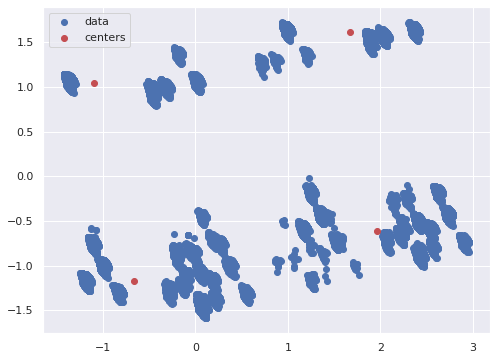

In [210]:
plt.figure(figsize=(8, 6))
plt.scatter(x_array[:,0], x_array[:,1], label="data")
plt.scatter(centers[:,0], centers[:,1],c='r', label="centers")
plt.legend()
plt.show()

Visualizamos las gaussianas

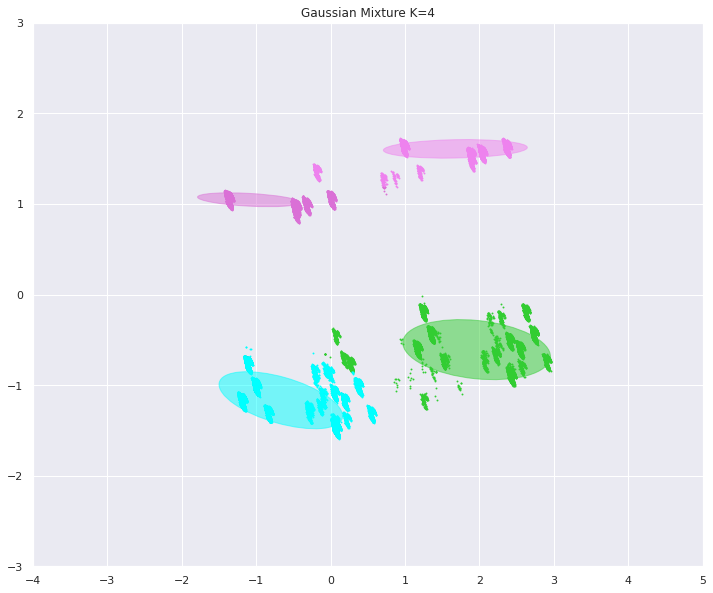

In [211]:
plot_results(x_array, 
             gm_train.predict(x_array), 
             centers, 
             covariances, 
             'Gaussian Mixture K=4'
            )


In [192]:
gm_train_3 = GaussianMixture(n_components=3, covariance_type='full').fit(X_principal_scaled)

Después de ajustar el modelo podemos obtener los centros de cada cluster.

In [193]:
centers1 = gm_train_3.means_
covariances1 = gm_train_3.covariances_
print(centers1)
print('\n')
print(covariances1)

[[-1.10931376  1.04562947]
 [-0.67006332 -1.16632083]
 [ 1.8303728   0.28643823]]


[[[ 0.22834125 -0.01049045]
  [-0.01049045  0.00286028]]

 [[ 0.34305773 -0.07160377]
  [-0.07160377  0.04980831]]

 [[ 0.52992732 -0.17846792]
  [-0.17846792  1.21383066]]]


Los centros pueden visualizarse en un gráfico

In [194]:
x_array_3 = X_principal_scaled.to_numpy()

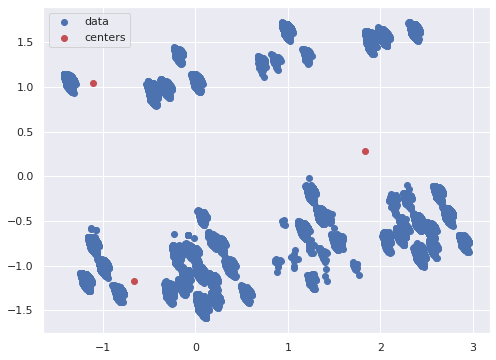

In [195]:
plt.figure(figsize=(8, 6))
plt.scatter(x_array_3[:,0], x_array_3[:,1], label="data")
plt.scatter(centers1[:,0], centers1[:,1],c='r', label="centers")
plt.legend()
plt.show()

Visualizamos las gaussianas

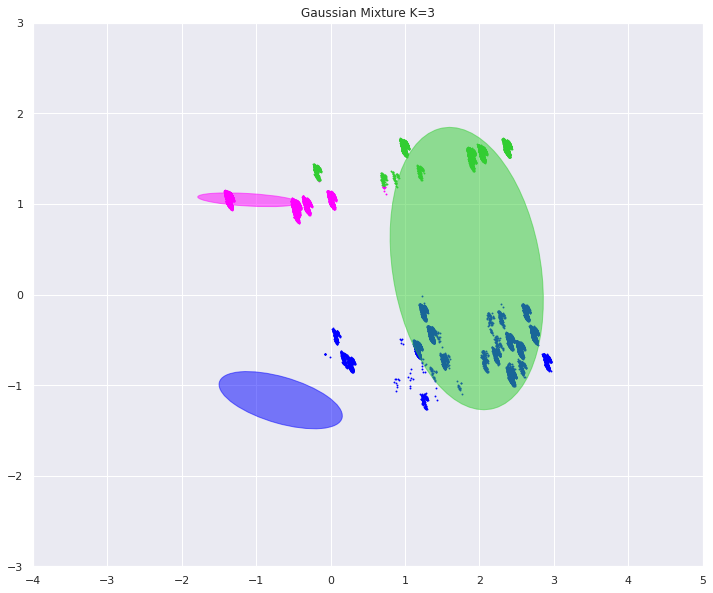

In [199]:
plot_results(x_array_3, 
             gm_train.predict(x_array_3), 
             centers, 
             covariances, 
             'Gaussian Mixture K=3'
             )


Habiendo visualizado ambos gráficos de las gaussianas con nro. de componentes de 3 y 4, concluimos que el parámetro de nro. de componentes más adecuado es 4.